# Afriat

In [1]:
scan=0.16

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

True

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

CUDA backend failed to initialize: Found cuDNN version 8700, but JAX was built against version 8907, which is newer. The copy of cuDNN that is installed must be at least as new as the version against which JAX was built. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: 55r72wu0
Name: feasible-blaze-106
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/55r72wu0
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_101835-55r72wu0/files



GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


You are using a CUDA device ('NVIDIA A100 80GB PCIe') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                             | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2608,3292,9343
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2608,2555,1721,3412,1626,3321
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4442,10801
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 597,817,2396
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 597,647,387,878,423,878
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1142,2668
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                  | 1/600 [00:11<1:53:53, 11.41s/it]

Epoch 1/600:   0%|▎                                                                                                                                                       | 1/600 [00:11<1:53:53, 11.41s/it, v_num=u0_1, total_loss_train=3.73e+3, kl_local_train=45.7]

Epoch 2/600:   0%|▎                                                                                                                                                       | 1/600 [00:11<1:53:53, 11.41s/it, v_num=u0_1, total_loss_train=3.73e+3, kl_local_train=45.7]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:17:04,  7.73s/it, v_num=u0_1, total_loss_train=3.73e+3, kl_local_train=45.7]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:17:04,  7.73s/it, v_num=u0_1, total_loss_train=3.23e+3, kl_local_train=60.5]

Epoch 3/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:17:04,  7.73s/it, v_num=u0_1, total_loss_train=3.23e+3, kl_local_train=60.5]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:21<1:05:08,  6.55s/it, v_num=u0_1, total_loss_train=3.23e+3, kl_local_train=60.5]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:21<1:05:08,  6.55s/it, v_num=u0_1, total_loss_train=3.22e+3, kl_local_train=58.2]

Epoch 4/600:   0%|▊                                                                                                                                                       | 3/600 [00:21<1:05:08,  6.55s/it, v_num=u0_1, total_loss_train=3.22e+3, kl_local_train=58.2]

Epoch 4/600:   1%|█                                                                                                                                                         | 4/600 [00:26<59:29,  5.99s/it, v_num=u0_1, total_loss_train=3.22e+3, kl_local_train=58.2]

Epoch 4/600:   1%|█                                                                                                                                                         | 4/600 [00:26<59:29,  5.99s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=52.9]

Epoch 5/600:   1%|█                                                                                                                                                         | 4/600 [00:26<59:29,  5.99s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=52.9]

Epoch 5/600:   1%|█▎                                                                                                                                                        | 5/600 [00:32<56:31,  5.70s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=52.9]

Epoch 5/600:   1%|█▎                                                                                                                                                        | 5/600 [00:32<56:31,  5.70s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=44.9]

Epoch 6/600:   1%|█▎                                                                                                                                                        | 5/600 [00:33<56:31,  5.70s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=44.9]

Epoch 6/600:   1%|█▌                                                                                                                                                        | 6/600 [00:38<58:07,  5.87s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=44.9]

Epoch 6/600:   1%|▏                     | 6/600 [00:38<58:07,  5.87s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=32.9, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 7/600:   1%|▏                     | 6/600 [00:38<58:07,  5.87s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=32.9, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 7/600:   1%|▎                     | 7/600 [00:43<55:40,  5.63s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=32.9, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 7/600:   1%|▎                     | 7/600 [00:43<55:40,  5.63s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=29.9, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 8/600:   1%|▎                     | 7/600 [00:43<55:40,  5.63s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=29.9, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 8/600:   1%|▎                     | 8/600 [00:48<54:04,  5.48s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=29.9, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 8/600:   1%|▎                     | 8/600 [00:48<54:04,  5.48s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=31.8, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 9/600:   1%|▎                     | 8/600 [00:48<54:04,  5.48s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=31.8, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 9/600:   2%|▎                     | 9/600 [00:53<52:56,  5.37s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=31.8, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 9/600:   2%|▎                     | 9/600 [00:53<52:56,  5.37s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=34.5, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 10/600:   2%|▎                    | 9/600 [00:53<52:56,  5.37s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=34.5, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 10/600:   2%|▎                   | 10/600 [00:58<52:10,  5.31s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=34.5, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 10/600:   2%|▎                   | 10/600 [00:58<52:10,  5.31s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 11/600:   2%|▎                   | 10/600 [00:59<52:10,  5.31s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 11/600:   2%|▎                   | 11/600 [01:04<54:39,  5.57s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0196, metric_mi|zone_train=0.00943, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0356]

Epoch 11/600:   2%|▍                    | 11/600 [01:04<54:39,  5.57s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 12/600:   2%|▍                    | 11/600 [01:04<54:39,  5.57s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 12/600:   2%|▍                    | 12/600 [01:10<53:15,  5.43s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 12/600:   2%|▍                    | 12/600 [01:10<53:15,  5.43s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 13/600:   2%|▍                    | 12/600 [01:10<53:15,  5.43s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 13/600:   2%|▍                    | 13/600 [01:15<52:18,  5.35s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 13/600:   2%|▍                      | 13/600 [01:15<52:18,  5.35s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=56, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 14/600:   2%|▍                      | 13/600 [01:15<52:18,  5.35s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=56, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 14/600:   2%|▌                      | 14/600 [01:20<51:34,  5.28s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=56, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 14/600:   2%|▍                    | 14/600 [01:20<51:34,  5.28s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=63.8, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 15/600:   2%|▍                    | 14/600 [01:20<51:34,  5.28s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=63.8, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 15/600:   2%|▌                    | 15/600 [01:25<51:04,  5.24s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=63.8, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 15/600:   2%|▌                    | 15/600 [01:25<51:04,  5.24s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=71.9, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 16/600:   2%|▌                    | 15/600 [01:26<51:04,  5.24s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=71.9, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 16/600:   3%|▌                    | 16/600 [01:31<53:36,  5.51s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=71.9, metric_mi|status_control_train=0.0461, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0723]

Epoch 16/600:   3%|▌                    | 16/600 [01:31<53:36,  5.51s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=82.4, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 17/600:   3%|▌                    | 16/600 [01:31<53:36,  5.51s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=82.4, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 17/600:   3%|▌                    | 17/600 [01:36<52:27,  5.40s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=82.4, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 17/600:   3%|▋                      | 17/600 [01:36<52:27,  5.40s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=89, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 18/600:   3%|▋                      | 17/600 [01:36<52:27,  5.40s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=89, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 18/600:   3%|▋                      | 18/600 [01:41<51:38,  5.32s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=89, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 18/600:   3%|▋                    | 18/600 [01:41<51:38,  5.32s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=94.3, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 19/600:   3%|▋                    | 18/600 [01:41<51:38,  5.32s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=94.3, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 19/600:   3%|▋                    | 19/600 [01:47<51:04,  5.27s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=94.3, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 19/600:   3%|▋                    | 19/600 [01:47<51:04,  5.27s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=97.4, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 20/600:   3%|▋                    | 19/600 [01:47<51:04,  5.27s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=97.4, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 20/600:   3%|▋                    | 20/600 [01:52<50:36,  5.24s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=97.4, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 20/600:   3%|▋                     | 20/600 [01:52<50:36,  5.24s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=104, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 21/600:   3%|▋                     | 20/600 [01:53<50:36,  5.24s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=104, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 21/600:   4%|▊                     | 21/600 [01:58<53:07,  5.50s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=104, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0707, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0945]

Epoch 21/600:   4%|▉                          | 21/600 [01:58<53:07,  5.50s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 22/600:   4%|▉                          | 21/600 [01:58<53:07,  5.50s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 22/600:   4%|▉                          | 22/600 [02:03<51:57,  5.39s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 22/600:   4%|▉                          | 22/600 [02:03<51:57,  5.39s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=115, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 23/600:   4%|▉                          | 22/600 [02:03<51:57,  5.39s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=115, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 23/600:   4%|█                          | 23/600 [02:08<51:10,  5.32s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=115, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 23/600:   4%|█                          | 23/600 [02:08<51:10,  5.32s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=120, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 24/600:   4%|█                          | 23/600 [02:08<51:10,  5.32s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=120, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 24/600:   4%|█                          | 24/600 [02:13<50:35,  5.27s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=120, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 24/600:   4%|█                          | 24/600 [02:13<50:35,  5.27s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=124, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 25/600:   4%|█                          | 24/600 [02:13<50:35,  5.27s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=124, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 25/600:   4%|█▏                         | 25/600 [02:18<50:12,  5.24s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=124, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 25/600:   4%|█▏                         | 25/600 [02:18<50:12,  5.24s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=127, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 26/600:   4%|█▏                         | 25/600 [02:20<50:12,  5.24s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=127, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 26/600:   4%|█▏                         | 26/600 [02:25<52:50,  5.52s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=127, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 26/600:   4%|█▏                        | 26/600 [02:25<52:50,  5.52s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=132, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 27/600:   4%|█▏                        | 26/600 [02:25<52:50,  5.52s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=132, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 27/600:   4%|█▏                        | 27/600 [02:30<51:42,  5.41s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=132, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 27/600:   4%|█▏                        | 27/600 [02:30<51:42,  5.41s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=131, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 28/600:   4%|█▏                        | 27/600 [02:30<51:42,  5.41s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=131, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 28/600:   5%|█▏                        | 28/600 [02:35<50:51,  5.33s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=131, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 28/600:   5%|█▏                        | 28/600 [02:35<50:51,  5.33s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=130, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 29/600:   5%|█▏                        | 28/600 [02:35<50:51,  5.33s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=130, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 29/600:   5%|█▎                        | 29/600 [02:40<50:17,  5.28s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=130, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 29/600:   5%|█▎                        | 29/600 [02:40<50:17,  5.28s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=129, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 30/600:   5%|█▎                        | 29/600 [02:40<50:17,  5.28s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=129, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 30/600:   5%|█▎                        | 30/600 [02:45<49:53,  5.25s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=129, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 30/600:   5%|█▎                        | 30/600 [02:45<49:53,  5.25s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=129, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 31/600:   5%|█▎                        | 30/600 [02:46<49:53,  5.25s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=129, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 31/600:   5%|█▎                        | 31/600 [02:51<52:22,  5.52s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=129, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.119]

Epoch 31/600:   5%|█▎                        | 31/600 [02:51<52:22,  5.52s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=127, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 32/600:   5%|█▎                        | 31/600 [02:51<52:22,  5.52s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=127, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 32/600:   5%|█▍                        | 32/600 [02:57<51:10,  5.41s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=127, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 32/600:   5%|█▍                        | 32/600 [02:57<51:10,  5.41s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=126, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 33/600:   5%|█▍                        | 32/600 [02:57<51:10,  5.41s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=126, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 33/600:   6%|█▍                        | 33/600 [03:02<50:20,  5.33s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=126, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 33/600:   6%|█▍                        | 33/600 [03:02<50:20,  5.33s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=126, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 34/600:   6%|█▍                        | 33/600 [03:02<50:20,  5.33s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=126, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 34/600:   6%|█▍                        | 34/600 [03:07<49:42,  5.27s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=126, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 34/600:   6%|█▍                        | 34/600 [03:07<49:42,  5.27s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=124, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 35/600:   6%|█▍                        | 34/600 [03:07<49:42,  5.27s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=124, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 35/600:   6%|█▌                        | 35/600 [03:12<49:15,  5.23s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=124, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 35/600:   6%|█▌                        | 35/600 [03:12<49:15,  5.23s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=123, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 36/600:   6%|█▌                        | 35/600 [03:13<49:15,  5.23s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=123, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 36/600:   6%|█▌                        | 36/600 [03:18<51:43,  5.50s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=123, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 36/600:   6%|█▌                         | 36/600 [03:18<51:43,  5.50s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 37/600:   6%|█▌                         | 36/600 [03:18<51:43,  5.50s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 37/600:   6%|█▋                         | 37/600 [03:23<50:37,  5.40s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 37/600:   6%|█▋                         | 37/600 [03:23<50:37,  5.40s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=125, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 38/600:   6%|█▋                         | 37/600 [03:23<50:37,  5.40s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=125, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 38/600:   6%|█▋                         | 38/600 [03:28<49:50,  5.32s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=125, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 38/600:   6%|█▋                         | 38/600 [03:28<49:50,  5.32s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=126, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 39/600:   6%|█▋                         | 38/600 [03:28<49:50,  5.32s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=126, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 39/600:   6%|█▊                         | 39/600 [03:34<49:21,  5.28s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=126, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 39/600:   6%|█▊                         | 39/600 [03:34<49:21,  5.28s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=125, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 40/600:   6%|█▊                         | 39/600 [03:34<49:21,  5.28s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=125, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 40/600:   7%|█▊                         | 40/600 [03:39<48:57,  5.25s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=125, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 40/600:   7%|█▊                         | 40/600 [03:39<48:57,  5.25s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 41/600:   7%|█▊                         | 40/600 [03:40<48:57,  5.25s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 41/600:   7%|█▊                         | 41/600 [03:45<51:26,  5.52s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 41/600:   7%|█▊                         | 41/600 [03:45<51:26,  5.52s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=123, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 42/600:   7%|█▊                         | 41/600 [03:45<51:26,  5.52s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=123, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 42/600:   7%|█▉                         | 42/600 [03:50<50:17,  5.41s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=123, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 42/600:   7%|█▉                         | 42/600 [03:50<50:17,  5.41s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=121, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 43/600:   7%|█▉                         | 42/600 [03:50<50:17,  5.41s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=121, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 43/600:   7%|█▉                         | 43/600 [03:55<49:32,  5.34s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=121, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 43/600:   7%|█▉                         | 43/600 [03:55<49:32,  5.34s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=122, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 44/600:   7%|█▉                         | 43/600 [03:55<49:32,  5.34s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=122, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 44/600:   7%|█▉                         | 44/600 [04:00<48:53,  5.28s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=122, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 44/600:   7%|█▉                         | 44/600 [04:00<48:53,  5.28s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=121, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 45/600:   7%|█▉                         | 44/600 [04:00<48:53,  5.28s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=121, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 45/600:   8%|██                         | 45/600 [04:06<48:26,  5.24s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=121, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 45/600:   8%|██                         | 45/600 [04:06<48:26,  5.24s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=121, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 46/600:   8%|██                         | 45/600 [04:07<48:26,  5.24s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=121, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 46/600:   8%|██                         | 46/600 [04:12<50:48,  5.50s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=121, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 46/600:   8%|██                         | 46/600 [04:12<50:48,  5.50s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=119, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|██                         | 46/600 [04:12<50:48,  5.50s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=119, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|██                         | 47/600 [04:17<49:44,  5.40s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=119, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|██                         | 47/600 [04:17<49:44,  5.40s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=119, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██                         | 47/600 [04:17<49:44,  5.40s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=119, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██▏                        | 48/600 [04:22<48:56,  5.32s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=119, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██▏                        | 48/600 [04:22<48:56,  5.32s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=118, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██▏                        | 48/600 [04:22<48:56,  5.32s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=118, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██▏                        | 49/600 [04:27<48:27,  5.28s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=118, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██▏                        | 49/600 [04:27<48:27,  5.28s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=118, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██▏                        | 49/600 [04:27<48:27,  5.28s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=118, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██▎                        | 50/600 [04:32<47:58,  5.23s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=118, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██▎                        | 50/600 [04:32<47:58,  5.23s/it, v_num=u0_1, total_loss_train=3.22e+3, kl_local_train=118, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▎                        | 50/600 [04:33<47:58,  5.23s/it, v_num=u0_1, total_loss_train=3.22e+3, kl_local_train=118, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▎                        | 51/600 [04:38<50:19,  5.50s/it, v_num=u0_1, total_loss_train=3.22e+3, kl_local_train=118, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▎                        | 51/600 [04:38<50:19,  5.50s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=116, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 52/600:   8%|██▎                        | 51/600 [04:38<50:19,  5.50s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=116, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 52/600:   9%|██▎                        | 52/600 [04:44<49:26,  5.41s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=116, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 52/600:   9%|██▎                        | 52/600 [04:44<49:26,  5.41s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 53/600:   9%|██▎                        | 52/600 [04:44<49:26,  5.41s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 53/600:   9%|██▍                        | 53/600 [04:49<48:38,  5.34s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 53/600:   9%|██▍                        | 53/600 [04:49<48:38,  5.34s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 54/600:   9%|██▍                        | 53/600 [04:49<48:38,  5.34s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 54/600:   9%|██▍                        | 54/600 [04:54<48:03,  5.28s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 54/600:   9%|██▍                        | 54/600 [04:54<48:03,  5.28s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 55/600:   9%|██▍                        | 54/600 [04:54<48:03,  5.28s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 55/600:   9%|██▍                        | 55/600 [04:59<47:34,  5.24s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 55/600:   9%|██▍                        | 55/600 [04:59<47:34,  5.24s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 56/600:   9%|██▍                        | 55/600 [05:00<47:34,  5.24s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 56/600:   9%|██▌                        | 56/600 [05:05<50:40,  5.59s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 56/600:   9%|██▍                       | 56/600 [05:05<50:40,  5.59s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 57/600:   9%|██▍                       | 56/600 [05:05<50:40,  5.59s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 57/600:  10%|██▍                       | 57/600 [05:11<49:35,  5.48s/it, v_num=u0_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 57/600:  10%|██▌                        | 57/600 [05:11<49:35,  5.48s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|██▌                        | 57/600 [05:11<49:35,  5.48s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|██▌                        | 58/600 [05:16<48:38,  5.38s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|██▌                        | 58/600 [05:16<48:38,  5.38s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|██▌                        | 58/600 [05:16<48:38,  5.38s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|██▋                        | 59/600 [05:21<47:52,  5.31s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|██▋                        | 59/600 [05:21<47:52,  5.31s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|██▋                        | 59/600 [05:21<47:52,  5.31s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|██▋                        | 60/600 [05:26<47:18,  5.26s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|██▋                        | 60/600 [05:26<47:18,  5.26s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|██▋                        | 60/600 [05:27<47:18,  5.26s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|██▋                        | 61/600 [05:32<49:30,  5.51s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|██▊                         | 61/600 [05:32<49:30,  5.51s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 62/600:  10%|██▊                         | 61/600 [05:32<49:30,  5.51s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 62/600:  10%|██▉                         | 62/600 [05:37<48:26,  5.40s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 62/600:  10%|██▉                         | 62/600 [05:37<48:26,  5.40s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 63/600:  10%|██▉                         | 62/600 [05:37<48:26,  5.40s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 63/600:  10%|██▉                         | 63/600 [05:43<47:49,  5.34s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 63/600:  10%|██▉                         | 63/600 [05:43<47:49,  5.34s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 64/600:  10%|██▉                         | 63/600 [05:43<47:49,  5.34s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 64/600:  11%|██▉                         | 64/600 [05:48<47:10,  5.28s/it, v_num=u0_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 64/600:  11%|██▉                        | 64/600 [05:48<47:10,  5.28s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 65/600:  11%|██▉                        | 64/600 [05:48<47:10,  5.28s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 65/600:  11%|██▉                        | 65/600 [05:53<46:41,  5.24s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 65/600:  11%|██▉                        | 65/600 [05:53<46:41,  5.24s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 66/600:  11%|██▉                        | 65/600 [05:54<46:41,  5.24s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 66/600:  11%|██▉                        | 66/600 [05:59<48:59,  5.51s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 66/600:  11%|██▊                       | 66/600 [05:59<48:59,  5.51s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 67/600:  11%|██▊                       | 66/600 [05:59<48:59,  5.51s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 67/600:  11%|██▉                       | 67/600 [06:04<47:56,  5.40s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 67/600:  11%|██▊                      | 67/600 [06:04<47:56,  5.40s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=99.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 68/600:  11%|██▊                      | 67/600 [06:04<47:56,  5.40s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=99.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 68/600:  11%|██▊                      | 68/600 [06:09<47:12,  5.32s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=99.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 68/600:  11%|██▉                       | 68/600 [06:09<47:12,  5.32s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 69/600:  11%|██▉                       | 68/600 [06:09<47:12,  5.32s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 69/600:  12%|██▉                       | 69/600 [06:14<46:37,  5.27s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 69/600:  12%|███                        | 69/600 [06:14<46:37,  5.27s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 70/600:  12%|███                        | 69/600 [06:14<46:37,  5.27s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 70/600:  12%|███▏                       | 70/600 [06:20<46:16,  5.24s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 70/600:  12%|██▉                      | 70/600 [06:20<46:16,  5.24s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=97.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 71/600:  12%|██▉                      | 70/600 [06:21<46:16,  5.24s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=97.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 71/600:  12%|██▉                      | 71/600 [06:26<48:44,  5.53s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=97.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 71/600:  12%|██▉                      | 71/600 [06:26<48:44,  5.53s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=95.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 72/600:  12%|██▉                      | 71/600 [06:26<48:44,  5.53s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=95.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 72/600:  12%|███                      | 72/600 [06:31<47:41,  5.42s/it, v_num=u0_1, total_loss_train=3.19e+3, kl_local_train=95.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 72/600:  12%|███                      | 72/600 [06:31<47:41,  5.42s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=95.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 73/600:  12%|███                      | 72/600 [06:31<47:41,  5.42s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=95.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 73/600:  12%|███                      | 73/600 [06:36<46:51,  5.33s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=95.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 73/600:  12%|███▎                       | 73/600 [06:36<46:51,  5.33s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=96, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 74/600:  12%|███▎                       | 73/600 [06:36<46:51,  5.33s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=96, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 74/600:  12%|███▎                       | 74/600 [06:41<46:44,  5.33s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=96, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 74/600:  12%|███                      | 74/600 [06:41<46:44,  5.33s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=94.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 75/600:  12%|███                      | 74/600 [06:41<46:44,  5.33s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=94.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 75/600:  12%|███▏                     | 75/600 [06:47<46:18,  5.29s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=94.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 75/600:  12%|███▏                     | 75/600 [06:47<46:18,  5.29s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=93.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 76/600:  12%|███▏                     | 75/600 [06:48<46:18,  5.29s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=93.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 76/600:  13%|███▏                     | 76/600 [06:53<48:25,  5.54s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=93.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 76/600:  13%|███▏                     | 76/600 [06:53<48:25,  5.54s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=94.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 77/600:  13%|███▏                     | 76/600 [06:53<48:25,  5.54s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=94.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 77/600:  13%|███▏                     | 77/600 [06:58<47:17,  5.42s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=94.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 77/600:  13%|███▏                     | 77/600 [06:58<47:17,  5.42s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=93.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 78/600:  13%|███▏                     | 77/600 [06:58<47:17,  5.42s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=93.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 78/600:  13%|███▎                     | 78/600 [07:03<46:27,  5.34s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=93.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 78/600:  13%|███▎                     | 78/600 [07:03<46:27,  5.34s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=91.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 79/600:  13%|███▎                     | 78/600 [07:03<46:27,  5.34s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=91.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 79/600:  13%|███▎                     | 79/600 [07:08<45:52,  5.28s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=91.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 79/600:  13%|███▎                     | 79/600 [07:08<45:52,  5.28s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 80/600:  13%|███▎                     | 79/600 [07:08<45:52,  5.28s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 80/600:  13%|███▎                     | 80/600 [07:13<45:29,  5.25s/it, v_num=u0_1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 80/600:  13%|███▎                     | 80/600 [07:13<45:29,  5.25s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=91.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 81/600:  13%|███▎                     | 80/600 [07:14<45:29,  5.25s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=91.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 81/600:  14%|███▍                     | 81/600 [07:20<47:48,  5.53s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=91.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 81/600:  14%|███▋                       | 81/600 [07:20<47:48,  5.53s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=90, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 82/600:  14%|███▋                       | 81/600 [07:20<47:48,  5.53s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=90, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 82/600:  14%|███▋                       | 82/600 [07:25<46:49,  5.42s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=90, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 82/600:  14%|███▍                     | 82/600 [07:25<46:49,  5.42s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=88.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 83/600:  14%|███▍                     | 82/600 [07:25<46:49,  5.42s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=88.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 83/600:  14%|███▍                     | 83/600 [07:30<46:02,  5.34s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=88.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 83/600:  14%|███▍                     | 83/600 [07:30<46:02,  5.34s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=88.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 84/600:  14%|███▍                     | 83/600 [07:30<46:02,  5.34s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=88.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 84/600:  14%|███▌                     | 84/600 [07:35<45:26,  5.28s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=88.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 84/600:  14%|███▌                     | 84/600 [07:35<45:26,  5.28s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=87.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 85/600:  14%|███▌                     | 84/600 [07:35<45:26,  5.28s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=87.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 85/600:  14%|███▌                     | 85/600 [07:40<44:57,  5.24s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=87.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 85/600:  14%|███▊                       | 85/600 [07:40<44:57,  5.24s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=87, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 86/600:  14%|███▊                       | 85/600 [07:41<44:57,  5.24s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=87, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 86/600:  14%|███▊                       | 86/600 [07:46<47:08,  5.50s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=87, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 86/600:  14%|███▌                     | 86/600 [07:46<47:08,  5.50s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=86.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 87/600:  14%|███▌                     | 86/600 [07:46<47:08,  5.50s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=86.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 87/600:  14%|███▌                     | 87/600 [07:51<46:11,  5.40s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=86.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 87/600:  14%|███▌                     | 87/600 [07:51<46:11,  5.40s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=86.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 88/600:  14%|███▌                     | 87/600 [07:51<46:11,  5.40s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=86.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 88/600:  15%|███▋                     | 88/600 [07:57<45:25,  5.32s/it, v_num=u0_1, total_loss_train=3.17e+3, kl_local_train=86.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 88/600:  15%|███▋                     | 88/600 [07:57<45:25,  5.32s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 89/600:  15%|███▋                     | 88/600 [07:57<45:25,  5.32s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 89/600:  15%|███▋                     | 89/600 [08:02<44:51,  5.27s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 89/600:  15%|███▋                     | 89/600 [08:02<44:51,  5.27s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=85.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 90/600:  15%|███▋                     | 89/600 [08:02<44:51,  5.27s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=85.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 90/600:  15%|███▊                     | 90/600 [08:07<44:26,  5.23s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=85.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 90/600:  15%|████                       | 90/600 [08:07<44:26,  5.23s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=85, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 91/600:  15%|████                       | 90/600 [08:08<44:26,  5.23s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=85, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 91/600:  15%|████                       | 91/600 [08:13<46:39,  5.50s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=85, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 91/600:  15%|███▊                     | 91/600 [08:13<46:39,  5.50s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=84.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 92/600:  15%|███▊                     | 91/600 [08:13<46:39,  5.50s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=84.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 92/600:  15%|███▊                     | 92/600 [08:18<45:40,  5.40s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=84.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 92/600:  15%|████▏                      | 92/600 [08:18<45:40,  5.40s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=84, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 93/600:  15%|████▏                      | 92/600 [08:18<45:40,  5.40s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=84, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 93/600:  16%|████▏                      | 93/600 [08:23<44:54,  5.31s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=84, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 93/600:  16%|████▏                      | 93/600 [08:23<44:54,  5.31s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=83, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 94/600:  16%|████▏                      | 93/600 [08:23<44:54,  5.31s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=83, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 94/600:  16%|████▏                      | 94/600 [08:28<44:22,  5.26s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=83, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 94/600:  16%|███▉                     | 94/600 [08:28<44:22,  5.26s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=82.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 95/600:  16%|███▉                     | 94/600 [08:28<44:22,  5.26s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=82.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 95/600:  16%|███▉                     | 95/600 [08:34<43:57,  5.22s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=82.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 95/600:  16%|███▉                     | 95/600 [08:34<43:57,  5.22s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=82.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 96/600:  16%|███▉                     | 95/600 [08:35<43:57,  5.22s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=82.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 96/600:  16%|████                     | 96/600 [08:40<46:07,  5.49s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=82.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 96/600:  16%|████▏                     | 96/600 [08:40<46:07,  5.49s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=82.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 97/600:  16%|████▏                     | 96/600 [08:40<46:07,  5.49s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=82.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 97/600:  16%|████▏                     | 97/600 [08:45<45:08,  5.38s/it, v_num=u0_1, total_loss_train=3.16e+3, kl_local_train=82.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 97/600:  16%|████▏                     | 97/600 [08:45<45:08,  5.38s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=81.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 98/600:  16%|████▏                     | 97/600 [08:45<45:08,  5.38s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=81.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 98/600:  16%|████▏                     | 98/600 [08:50<44:26,  5.31s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=81.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 98/600:  16%|████▏                     | 98/600 [08:50<44:26,  5.31s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=81.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 99/600:  16%|████▏                     | 98/600 [08:50<44:26,  5.31s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=81.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 99/600:  16%|████▎                     | 99/600 [08:55<43:53,  5.26s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=81.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 99/600:  16%|████▎                     | 99/600 [08:55<43:53,  5.26s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=81.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 100/600:  16%|████▏                    | 99/600 [08:55<43:53,  5.26s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=81.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 100/600:  17%|████                    | 100/600 [09:00<43:33,  5.23s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=81.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 100/600:  17%|████                    | 100/600 [09:00<43:33,  5.23s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=80.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 101/600:  17%|████                    | 100/600 [09:01<43:33,  5.23s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=80.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 101/600:  17%|████                    | 101/600 [09:06<45:41,  5.49s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=80.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 101/600:  17%|███▊                   | 101/600 [09:06<45:41,  5.49s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=80.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 102/600:  17%|███▊                   | 101/600 [09:06<45:41,  5.49s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=80.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 102/600:  17%|███▉                   | 102/600 [09:11<44:42,  5.39s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=80.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 102/600:  17%|███▉                   | 102/600 [09:11<44:42,  5.39s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=80.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 103/600:  17%|███▉                   | 102/600 [09:11<44:42,  5.39s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=80.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 103/600:  17%|███▉                   | 103/600 [09:17<44:02,  5.32s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=80.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 103/600:  17%|███▉                   | 103/600 [09:17<44:02,  5.32s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=79.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 104/600:  17%|███▉                   | 103/600 [09:17<44:02,  5.32s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=79.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 104/600:  17%|███▉                   | 104/600 [09:22<43:35,  5.27s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=79.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 104/600:  17%|███▉                   | 104/600 [09:22<43:35,  5.27s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=78.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 105/600:  17%|███▉                   | 104/600 [09:22<43:35,  5.27s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=78.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 105/600:  18%|████                   | 105/600 [09:27<43:12,  5.24s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=78.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 105/600:  18%|████                   | 105/600 [09:27<43:12,  5.24s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=78.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 106/600:  18%|████                   | 105/600 [09:28<43:12,  5.24s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=78.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 106/600:  18%|████                   | 106/600 [09:33<45:36,  5.54s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=78.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 106/600:  18%|████▏                   | 106/600 [09:33<45:36,  5.54s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 107/600:  18%|████▏                   | 106/600 [09:33<45:36,  5.54s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 107/600:  18%|████▎                   | 107/600 [09:38<44:39,  5.44s/it, v_num=u0_1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 107/600:  18%|████▎                   | 107/600 [09:38<44:39,  5.44s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=77.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 108/600:  18%|████▎                   | 107/600 [09:38<44:39,  5.44s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=77.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 108/600:  18%|████▎                   | 108/600 [09:44<43:58,  5.36s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=77.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 108/600:  18%|████▎                   | 108/600 [09:44<43:58,  5.36s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=77.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 109/600:  18%|████▎                   | 108/600 [09:44<43:58,  5.36s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=77.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 109/600:  18%|████▎                   | 109/600 [09:49<43:32,  5.32s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=77.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 109/600:  18%|████▎                   | 109/600 [09:49<43:32,  5.32s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 110/600:  18%|████▎                   | 109/600 [09:49<43:32,  5.32s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 110/600:  18%|████▍                   | 110/600 [09:54<43:06,  5.28s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 110/600:  18%|████▍                   | 110/600 [09:54<43:06,  5.28s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=76.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 111/600:  18%|████▍                   | 110/600 [09:55<43:06,  5.28s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=76.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 111/600:  18%|████▍                   | 111/600 [10:00<45:20,  5.56s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=76.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 111/600:  18%|████▎                  | 111/600 [10:00<45:20,  5.56s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=76.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 112/600:  18%|████▎                  | 111/600 [10:00<45:20,  5.56s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=76.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 112/600:  19%|████▎                  | 112/600 [10:05<44:23,  5.46s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=76.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 112/600:  19%|████▎                  | 112/600 [10:05<44:23,  5.46s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=75.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 113/600:  19%|████▎                  | 112/600 [10:05<44:23,  5.46s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=75.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 113/600:  19%|████▎                  | 113/600 [10:11<43:39,  5.38s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=75.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 113/600:  19%|████▎                  | 113/600 [10:11<43:39,  5.38s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=75.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 114/600:  19%|████▎                  | 113/600 [10:11<43:39,  5.38s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=75.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 114/600:  19%|████▎                  | 114/600 [10:16<43:08,  5.33s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=75.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 114/600:  19%|████▎                  | 114/600 [10:16<43:08,  5.33s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=75.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 115/600:  19%|████▎                  | 114/600 [10:16<43:08,  5.33s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=75.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 115/600:  19%|████▍                  | 115/600 [10:21<42:39,  5.28s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=75.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 115/600:  19%|████▍                  | 115/600 [10:21<42:39,  5.28s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 116/600:  19%|████▍                  | 115/600 [10:22<42:39,  5.28s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 116/600:  19%|████▍                  | 116/600 [10:27<44:48,  5.55s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 116/600:  19%|████▍                  | 116/600 [10:27<44:48,  5.55s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=74.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 117/600:  19%|████▍                  | 116/600 [10:27<44:48,  5.55s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=74.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 117/600:  20%|████▍                  | 117/600 [10:32<43:47,  5.44s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=74.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 117/600:  20%|████▍                  | 117/600 [10:32<43:47,  5.44s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=74.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 118/600:  20%|████▍                  | 117/600 [10:32<43:47,  5.44s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=74.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 118/600:  20%|████▌                  | 118/600 [10:37<42:55,  5.34s/it, v_num=u0_1, total_loss_train=3.14e+3, kl_local_train=74.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 118/600:  20%|████▌                  | 118/600 [10:37<42:55,  5.34s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 119/600:  20%|████▌                  | 118/600 [10:37<42:55,  5.34s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 119/600:  20%|████▌                  | 119/600 [10:43<42:15,  5.27s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 119/600:  20%|████▌                  | 119/600 [10:43<42:15,  5.27s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 120/600:  20%|████▌                  | 119/600 [10:43<42:15,  5.27s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 120/600:  20%|████▌                  | 120/600 [10:48<42:04,  5.26s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 120/600:  20%|████▌                  | 120/600 [10:48<42:04,  5.26s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=73.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 121/600:  20%|████▌                  | 120/600 [10:49<42:04,  5.26s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=73.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 121/600:  20%|████▋                  | 121/600 [10:54<44:02,  5.52s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=73.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 121/600:  20%|████▋                  | 121/600 [10:54<44:02,  5.52s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=73.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|████▋                  | 121/600 [10:54<44:02,  5.52s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=73.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|████▋                  | 122/600 [10:59<43:00,  5.40s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=73.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|████▋                  | 122/600 [10:59<43:00,  5.40s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=73.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|████▋                  | 122/600 [10:59<43:00,  5.40s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=73.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|████▋                  | 123/600 [11:04<42:16,  5.32s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=73.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|████▋                  | 123/600 [11:04<42:16,  5.32s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=72.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 124/600:  20%|████▋                  | 123/600 [11:04<42:16,  5.32s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=72.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 124/600:  21%|████▊                  | 124/600 [11:09<41:45,  5.26s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=72.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 124/600:  21%|████▊                  | 124/600 [11:09<41:45,  5.26s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=72.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|████▊                  | 124/600 [11:09<41:45,  5.26s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=72.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|████▊                  | 125/600 [11:14<41:22,  5.23s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=72.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|████▊                  | 125/600 [11:14<41:22,  5.23s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|████▊                  | 125/600 [11:15<41:22,  5.23s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|████▊                  | 126/600 [11:21<43:21,  5.49s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|████▊                  | 126/600 [11:21<43:21,  5.49s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=71.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 127/600:  21%|████▊                  | 126/600 [11:21<43:21,  5.49s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=71.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 127/600:  21%|████▊                  | 127/600 [11:26<42:25,  5.38s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=71.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 127/600:  21%|████▊                  | 127/600 [11:26<42:25,  5.38s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=71.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 128/600:  21%|████▊                  | 127/600 [11:26<42:25,  5.38s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=71.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 128/600:  21%|████▉                  | 128/600 [11:31<41:44,  5.31s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=71.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 128/600:  21%|████▉                  | 128/600 [11:31<41:44,  5.31s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=71.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 129/600:  21%|████▉                  | 128/600 [11:31<41:44,  5.31s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=71.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 129/600:  22%|████▉                  | 129/600 [11:36<41:35,  5.30s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=71.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 129/600:  22%|████▉                  | 129/600 [11:36<41:35,  5.30s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=71.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 130/600:  22%|████▉                  | 129/600 [11:36<41:35,  5.30s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=71.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 130/600:  22%|████▉                  | 130/600 [11:41<41:19,  5.27s/it, v_num=u0_1, total_loss_train=3.13e+3, kl_local_train=71.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 130/600:  22%|████▉                  | 130/600 [11:41<41:19,  5.27s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 131/600:  22%|████▉                  | 130/600 [11:42<41:19,  5.27s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 131/600:  22%|█████                  | 131/600 [11:48<44:01,  5.63s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 131/600:  22%|█████                  | 131/600 [11:48<44:01,  5.63s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 132/600:  22%|█████                  | 131/600 [11:48<44:01,  5.63s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 132/600:  22%|█████                  | 132/600 [11:53<42:54,  5.50s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 132/600:  22%|█████                  | 132/600 [11:53<42:54,  5.50s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 133/600:  22%|█████                  | 132/600 [11:53<42:54,  5.50s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 133/600:  22%|█████                  | 133/600 [11:58<42:13,  5.43s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 133/600:  22%|█████                  | 133/600 [11:58<42:13,  5.43s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 134/600:  22%|█████                  | 133/600 [11:58<42:13,  5.43s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 134/600:  22%|█████▏                 | 134/600 [12:03<41:41,  5.37s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 134/600:  22%|█████▏                 | 134/600 [12:03<41:41,  5.37s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 135/600:  22%|█████▏                 | 134/600 [12:03<41:41,  5.37s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 135/600:  22%|█████▏                 | 135/600 [12:09<41:16,  5.33s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 135/600:  22%|█████▋                   | 135/600 [12:09<41:16,  5.33s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 136/600:  22%|█████▋                   | 135/600 [12:10<41:16,  5.33s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 136/600:  23%|█████▋                   | 136/600 [12:15<43:19,  5.60s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 136/600:  23%|█████▍                  | 136/600 [12:15<43:19,  5.60s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 137/600:  23%|█████▍                  | 136/600 [12:15<43:19,  5.60s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 137/600:  23%|█████▍                  | 137/600 [12:20<42:28,  5.50s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 137/600:  23%|█████▍                  | 137/600 [12:20<42:28,  5.50s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 138/600:  23%|█████▍                  | 137/600 [12:20<42:28,  5.50s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 138/600:  23%|█████▌                  | 138/600 [12:25<41:48,  5.43s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 138/600:  23%|█████▌                  | 138/600 [12:25<41:48,  5.43s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 139/600:  23%|█████▌                  | 138/600 [12:25<41:48,  5.43s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 139/600:  23%|█████▌                  | 139/600 [12:31<41:21,  5.38s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 139/600:  23%|█████▌                  | 139/600 [12:31<41:21,  5.38s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 140/600:  23%|█████▌                  | 139/600 [12:31<41:21,  5.38s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 140/600:  23%|█████▌                  | 140/600 [12:36<40:54,  5.33s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 140/600:  23%|█████▌                  | 140/600 [12:36<40:54,  5.33s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 141/600:  23%|█████▌                  | 140/600 [12:37<40:54,  5.33s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 141/600:  24%|█████▋                  | 141/600 [12:42<42:52,  5.60s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 141/600:  24%|█████▉                   | 141/600 [12:42<42:52,  5.60s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 142/600:  24%|█████▉                   | 141/600 [12:42<42:52,  5.60s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 142/600:  24%|█████▉                   | 142/600 [12:47<41:56,  5.49s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=69, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 142/600:  24%|█████▍                 | 142/600 [12:47<41:56,  5.49s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 143/600:  24%|█████▍                 | 142/600 [12:47<41:56,  5.49s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 143/600:  24%|█████▍                 | 143/600 [12:53<41:18,  5.42s/it, v_num=u0_1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 143/600:  24%|█████▍                 | 143/600 [12:53<41:18,  5.42s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 144/600:  24%|█████▍                 | 143/600 [12:53<41:18,  5.42s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 144/600:  24%|█████▌                 | 144/600 [12:58<40:49,  5.37s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 144/600:  24%|█████▌                 | 144/600 [12:58<40:49,  5.37s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 145/600:  24%|█████▌                 | 144/600 [12:58<40:49,  5.37s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 145/600:  24%|█████▌                 | 145/600 [13:03<40:21,  5.32s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 145/600:  24%|█████▌                 | 145/600 [13:03<40:21,  5.32s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 146/600:  24%|█████▌                 | 145/600 [13:04<40:21,  5.32s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 146/600:  24%|█████▌                 | 146/600 [13:09<42:16,  5.59s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 146/600:  24%|█████▌                 | 146/600 [13:09<42:16,  5.59s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 147/600:  24%|█████▌                 | 146/600 [13:09<42:16,  5.59s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 147/600:  24%|█████▋                 | 147/600 [13:15<41:24,  5.48s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 147/600:  24%|█████▋                 | 147/600 [13:15<41:24,  5.48s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 148/600:  24%|█████▋                 | 147/600 [13:15<41:24,  5.48s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 148/600:  25%|█████▋                 | 148/600 [13:20<40:46,  5.41s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 148/600:  25%|█████▋                 | 148/600 [13:20<40:46,  5.41s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 149/600:  25%|█████▋                 | 148/600 [13:20<40:46,  5.41s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 149/600:  25%|█████▋                 | 149/600 [13:25<40:14,  5.35s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 149/600:  25%|█████▋                 | 149/600 [13:25<40:14,  5.35s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 150/600:  25%|█████▋                 | 149/600 [13:25<40:14,  5.35s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 150/600:  25%|█████▊                 | 150/600 [13:30<39:53,  5.32s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 150/600:  25%|█████▊                 | 150/600 [13:30<39:53,  5.32s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 151/600:  25%|█████▊                 | 150/600 [13:31<39:53,  5.32s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 151/600:  25%|█████▊                 | 151/600 [13:37<41:53,  5.60s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=67.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 151/600:  25%|█████▊                 | 151/600 [13:37<41:53,  5.60s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 152/600:  25%|█████▊                 | 151/600 [13:37<41:53,  5.60s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 152/600:  25%|█████▊                 | 152/600 [13:42<40:57,  5.49s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 152/600:  25%|█████▊                 | 152/600 [13:42<40:57,  5.49s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 153/600:  25%|█████▊                 | 152/600 [13:42<40:57,  5.49s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 153/600:  26%|█████▊                 | 153/600 [13:47<40:20,  5.42s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 153/600:  26%|█████▊                 | 153/600 [13:47<40:20,  5.42s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 154/600:  26%|█████▊                 | 153/600 [13:47<40:20,  5.42s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 154/600:  26%|█████▉                 | 154/600 [13:52<39:56,  5.37s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 154/600:  26%|█████▉                 | 154/600 [13:52<39:56,  5.37s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 155/600:  26%|█████▉                 | 154/600 [13:52<39:56,  5.37s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 155/600:  26%|█████▉                 | 155/600 [13:58<39:31,  5.33s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 155/600:  26%|██████▍                  | 155/600 [13:58<39:31,  5.33s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 156/600:  26%|██████▍                  | 155/600 [13:59<39:31,  5.33s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 156/600:  26%|██████▌                  | 156/600 [14:04<41:23,  5.59s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=66, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.111]

Epoch 156/600:  26%|█████▉                 | 156/600 [14:04<41:23,  5.59s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=65.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 157/600:  26%|█████▉                 | 156/600 [14:04<41:23,  5.59s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=65.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 157/600:  26%|██████                 | 157/600 [14:09<40:28,  5.48s/it, v_num=u0_1, total_loss_train=3.11e+3, kl_local_train=65.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 157/600:  26%|██████▎                 | 157/600 [14:09<40:28,  5.48s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 158/600:  26%|██████▎                 | 157/600 [14:09<40:28,  5.48s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 158/600:  26%|██████▎                 | 158/600 [14:14<39:50,  5.41s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 158/600:  26%|██████▎                 | 158/600 [14:14<39:50,  5.41s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 159/600:  26%|██████▎                 | 158/600 [14:14<39:50,  5.41s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 159/600:  26%|██████▎                 | 159/600 [14:19<39:25,  5.36s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 159/600:  26%|██████▎                 | 159/600 [14:19<39:25,  5.36s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 160/600:  26%|██████▎                 | 159/600 [14:19<39:25,  5.36s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 160/600:  27%|██████▍                 | 160/600 [14:25<39:02,  5.32s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 160/600:  27%|██████▍                 | 160/600 [14:25<39:02,  5.32s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 161/600:  27%|██████▍                 | 160/600 [14:26<39:02,  5.32s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 161/600:  27%|██████▍                 | 161/600 [14:31<40:53,  5.59s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 161/600:  27%|██████▍                 | 161/600 [14:31<40:53,  5.59s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 162/600:  27%|██████▍                 | 161/600 [14:31<40:53,  5.59s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 162/600:  27%|██████▍                 | 162/600 [14:36<40:00,  5.48s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 162/600:  27%|██████▍                 | 162/600 [14:36<40:00,  5.48s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 163/600:  27%|██████▍                 | 162/600 [14:36<40:00,  5.48s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 163/600:  27%|██████▌                 | 163/600 [14:41<39:23,  5.41s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 163/600:  27%|██████▌                 | 163/600 [14:41<39:23,  5.41s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 164/600:  27%|██████▌                 | 163/600 [14:41<39:23,  5.41s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 164/600:  27%|██████▌                 | 164/600 [14:47<38:53,  5.35s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 164/600:  27%|██████▌                 | 164/600 [14:47<38:53,  5.35s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 165/600:  27%|██████▌                 | 164/600 [14:47<38:53,  5.35s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 165/600:  28%|██████▌                 | 165/600 [14:52<38:37,  5.33s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 165/600:  28%|██████▌                 | 165/600 [14:52<38:37,  5.33s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 166/600:  28%|██████▌                 | 165/600 [14:53<38:37,  5.33s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 166/600:  28%|██████▋                 | 166/600 [14:58<40:29,  5.60s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 166/600:  28%|██████▉                  | 166/600 [14:58<40:29,  5.60s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 167/600:  28%|██████▉                  | 166/600 [14:58<40:29,  5.60s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 167/600:  28%|██████▉                  | 167/600 [15:03<39:36,  5.49s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 167/600:  28%|██████▉                  | 167/600 [15:03<39:36,  5.49s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 168/600:  28%|██████▉                  | 167/600 [15:03<39:36,  5.49s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 168/600:  28%|███████                  | 168/600 [15:09<38:55,  5.41s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 168/600:  28%|███████                  | 168/600 [15:09<38:55,  5.41s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 169/600:  28%|███████                  | 168/600 [15:09<38:55,  5.41s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 169/600:  28%|███████                  | 169/600 [15:14<38:31,  5.36s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 169/600:  28%|███████                  | 169/600 [15:14<38:31,  5.36s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 170/600:  28%|███████                  | 169/600 [15:14<38:31,  5.36s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 170/600:  28%|███████                  | 170/600 [15:19<38:04,  5.31s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 170/600:  28%|███████                  | 170/600 [15:19<38:04,  5.31s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 171/600:  28%|███████                  | 170/600 [15:20<38:04,  5.31s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 171/600:  28%|███████                  | 171/600 [15:25<39:53,  5.58s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 171/600:  28%|██████▊                 | 171/600 [15:25<39:53,  5.58s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 172/600:  28%|██████▊                 | 171/600 [15:25<39:53,  5.58s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 172/600:  29%|██████▉                 | 172/600 [15:30<38:58,  5.46s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 172/600:  29%|██████▉                 | 172/600 [15:30<38:58,  5.46s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 173/600:  29%|██████▉                 | 172/600 [15:30<38:58,  5.46s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 173/600:  29%|██████▉                 | 173/600 [15:36<38:15,  5.37s/it, v_num=u0_1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 173/600:  29%|██████▋                | 173/600 [15:36<38:15,  5.37s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 174/600:  29%|██████▋                | 173/600 [15:36<38:15,  5.37s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 174/600:  29%|██████▋                | 174/600 [15:41<37:45,  5.32s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 174/600:  29%|██████▋                | 174/600 [15:41<37:45,  5.32s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 175/600:  29%|██████▋                | 174/600 [15:41<37:45,  5.32s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 175/600:  29%|██████▋                | 175/600 [15:46<37:25,  5.28s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 175/600:  29%|███████▎                 | 175/600 [15:46<37:25,  5.28s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=63, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 176/600:  29%|███████▎                 | 175/600 [15:47<37:25,  5.28s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=63, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 176/600:  29%|███████▎                 | 176/600 [15:52<39:27,  5.58s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=63, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 176/600:  29%|██████▋                | 176/600 [15:52<39:27,  5.58s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 177/600:  29%|██████▋                | 176/600 [15:52<39:27,  5.58s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 177/600:  30%|██████▊                | 177/600 [15:57<38:38,  5.48s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 177/600:  30%|██████▊                | 177/600 [15:57<38:38,  5.48s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 178/600:  30%|██████▊                | 177/600 [15:57<38:38,  5.48s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 178/600:  30%|██████▊                | 178/600 [16:03<37:58,  5.40s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 178/600:  30%|██████▊                | 178/600 [16:03<37:58,  5.40s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 179/600:  30%|██████▊                | 178/600 [16:03<37:58,  5.40s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 179/600:  30%|██████▊                | 179/600 [16:08<37:36,  5.36s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 179/600:  30%|██████▊                | 179/600 [16:08<37:36,  5.36s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 180/600:  30%|██████▊                | 179/600 [16:08<37:36,  5.36s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 180/600:  30%|██████▉                | 180/600 [16:13<37:15,  5.32s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 180/600:  30%|██████▉                | 180/600 [16:13<37:15,  5.32s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 181/600:  30%|██████▉                | 180/600 [16:14<37:15,  5.32s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 181/600:  30%|██████▉                | 181/600 [16:19<39:01,  5.59s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 181/600:  30%|██████▉                | 181/600 [16:19<39:01,  5.59s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 182/600:  30%|██████▉                | 181/600 [16:19<39:01,  5.59s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 182/600:  30%|██████▉                | 182/600 [16:25<38:10,  5.48s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 182/600:  30%|███████▌                 | 182/600 [16:25<38:10,  5.48s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 183/600:  30%|███████▌                 | 182/600 [16:25<38:10,  5.48s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 183/600:  30%|███████▋                 | 183/600 [16:30<37:29,  5.39s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 183/600:  30%|███████                | 183/600 [16:30<37:29,  5.39s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 184/600:  30%|███████                | 183/600 [16:30<37:29,  5.39s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 184/600:  31%|███████                | 184/600 [16:35<37:07,  5.35s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 184/600:  31%|███████                | 184/600 [16:35<37:07,  5.35s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 185/600:  31%|███████                | 184/600 [16:35<37:07,  5.35s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 185/600:  31%|███████                | 185/600 [16:40<36:36,  5.29s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 185/600:  31%|███████                | 185/600 [16:40<36:36,  5.29s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 186/600:  31%|███████                | 185/600 [16:41<36:36,  5.29s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 186/600:  31%|███████▏               | 186/600 [16:47<38:37,  5.60s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 186/600:  31%|███████▏               | 186/600 [16:47<38:37,  5.60s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 187/600:  31%|███████▏               | 186/600 [16:47<38:37,  5.60s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 187/600:  31%|███████▏               | 187/600 [16:52<37:39,  5.47s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 187/600:  31%|███████▏               | 187/600 [16:52<37:39,  5.47s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 188/600:  31%|███████▏               | 187/600 [16:52<37:39,  5.47s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 188/600:  31%|███████▏               | 188/600 [16:57<36:55,  5.38s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 188/600:  31%|███████▏               | 188/600 [16:57<36:55,  5.38s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 189/600:  31%|███████▏               | 188/600 [16:57<36:55,  5.38s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 189/600:  32%|███████▏               | 189/600 [17:02<36:24,  5.32s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 189/600:  32%|███████▏               | 189/600 [17:02<36:24,  5.32s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 190/600:  32%|███████▏               | 189/600 [17:02<36:24,  5.32s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 190/600:  32%|███████▎               | 190/600 [17:07<35:59,  5.27s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 190/600:  32%|███████▎               | 190/600 [17:07<35:59,  5.27s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.3, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 191/600:  32%|███████▎               | 190/600 [17:08<35:59,  5.27s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.3, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 191/600:  32%|███████▎               | 191/600 [17:13<37:42,  5.53s/it, v_num=u0_1, total_loss_train=3.09e+3, kl_local_train=61.3, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 191/600:  32%|███████▋                | 191/600 [17:13<37:42,  5.53s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 192/600:  32%|███████▋                | 191/600 [17:13<37:42,  5.53s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 192/600:  32%|███████▋                | 192/600 [17:18<36:46,  5.41s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 192/600:  32%|███████▋                | 192/600 [17:18<36:46,  5.41s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 193/600:  32%|███████▋                | 192/600 [17:18<36:46,  5.41s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 193/600:  32%|███████▋                | 193/600 [17:24<36:07,  5.33s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 193/600:  32%|███████▋                | 193/600 [17:24<36:07,  5.33s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 194/600:  32%|███████▋                | 193/600 [17:24<36:07,  5.33s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 194/600:  32%|███████▊                | 194/600 [17:29<35:37,  5.27s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 194/600:  32%|███████▊                | 194/600 [17:29<35:37,  5.27s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 195/600:  32%|███████▊                | 194/600 [17:29<35:37,  5.27s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 195/600:  32%|███████▊                | 195/600 [17:34<35:13,  5.22s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 195/600:  32%|███████▊                | 195/600 [17:34<35:13,  5.22s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 196/600:  32%|███████▊                | 195/600 [17:35<35:13,  5.22s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 196/600:  33%|███████▊                | 196/600 [17:40<36:57,  5.49s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 196/600:  33%|███████▊                | 196/600 [17:40<36:57,  5.49s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 197/600:  33%|███████▊                | 196/600 [17:40<36:57,  5.49s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 197/600:  33%|███████▉                | 197/600 [17:45<36:08,  5.38s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 197/600:  33%|███████▉                | 197/600 [17:45<36:08,  5.38s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 198/600:  33%|███████▉                | 197/600 [17:45<36:08,  5.38s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 198/600:  33%|███████▉                | 198/600 [17:50<35:34,  5.31s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 198/600:  33%|███████▉                | 198/600 [17:50<35:34,  5.31s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 199/600:  33%|███████▉                | 198/600 [17:50<35:34,  5.31s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 199/600:  33%|███████▉                | 199/600 [17:55<35:06,  5.25s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 199/600:  33%|███████▉                | 199/600 [17:55<35:06,  5.25s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 200/600:  33%|███████▉                | 199/600 [17:55<35:06,  5.25s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 200/600:  33%|████████                | 200/600 [18:00<34:44,  5.21s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 200/600:  33%|████████                | 200/600 [18:00<34:44,  5.21s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 201/600:  33%|████████                | 200/600 [18:01<34:44,  5.21s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 201/600:  34%|████████                | 201/600 [18:07<36:26,  5.48s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 201/600:  34%|███████▎              | 201/600 [18:07<36:26,  5.48s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 202/600:  34%|███████▎              | 201/600 [18:07<36:26,  5.48s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 202/600:  34%|███████▍              | 202/600 [18:12<35:40,  5.38s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 202/600:  34%|███████▍              | 202/600 [18:12<35:40,  5.38s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 203/600:  34%|███████▍              | 202/600 [18:12<35:40,  5.38s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 203/600:  34%|███████▍              | 203/600 [18:17<35:10,  5.32s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 203/600:  34%|████████                | 203/600 [18:17<35:10,  5.32s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 204/600:  34%|████████                | 203/600 [18:17<35:10,  5.32s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 204/600:  34%|████████▏               | 204/600 [18:22<34:45,  5.27s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 204/600:  34%|███████▍              | 204/600 [18:22<34:45,  5.27s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 205/600:  34%|███████▍              | 204/600 [18:22<34:45,  5.27s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 205/600:  34%|███████▌              | 205/600 [18:27<34:27,  5.23s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 205/600:  34%|████████▏               | 205/600 [18:27<34:27,  5.23s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 206/600:  34%|████████▏               | 205/600 [18:28<34:27,  5.23s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 206/600:  34%|████████▏               | 206/600 [18:33<36:06,  5.50s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=60, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.102]

Epoch 206/600:  34%|███████▌              | 206/600 [18:33<36:06,  5.50s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 207/600:  34%|███████▌              | 206/600 [18:33<36:06,  5.50s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 207/600:  34%|███████▌              | 207/600 [18:38<35:15,  5.38s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 207/600:  34%|███████▌              | 207/600 [18:38<35:15,  5.38s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 208/600:  34%|███████▌              | 207/600 [18:38<35:15,  5.38s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 208/600:  35%|███████▋              | 208/600 [18:44<34:39,  5.30s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 208/600:  35%|███████▋              | 208/600 [18:44<34:39,  5.30s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 209/600:  35%|███████▋              | 208/600 [18:44<34:39,  5.30s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 209/600:  35%|███████▋              | 209/600 [18:49<34:12,  5.25s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 209/600:  35%|███████▋              | 209/600 [18:49<34:12,  5.25s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 210/600:  35%|███████▋              | 209/600 [18:49<34:12,  5.25s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 210/600:  35%|███████▋              | 210/600 [18:54<33:51,  5.21s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 210/600:  35%|███████▋              | 210/600 [18:54<33:51,  5.21s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 211/600:  35%|███████▋              | 210/600 [18:55<33:51,  5.21s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 211/600:  35%|███████▋              | 211/600 [19:00<35:33,  5.48s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.102]

Epoch 211/600:  35%|███████▋              | 211/600 [19:00<35:33,  5.48s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 212/600:  35%|███████▋              | 211/600 [19:00<35:33,  5.48s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 212/600:  35%|███████▊              | 212/600 [19:05<34:45,  5.38s/it, v_num=u0_1, total_loss_train=3.08e+3, kl_local_train=59.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 212/600:  35%|███████▊              | 212/600 [19:05<34:45,  5.38s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 213/600:  35%|███████▊              | 212/600 [19:05<34:45,  5.38s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 213/600:  36%|███████▊              | 213/600 [19:10<34:09,  5.30s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 213/600:  36%|███████▊              | 213/600 [19:10<34:09,  5.30s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=59.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 214/600:  36%|███████▊              | 213/600 [19:10<34:09,  5.30s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=59.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 214/600:  36%|███████▊              | 214/600 [19:15<33:42,  5.24s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=59.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 214/600:  36%|███████▊              | 214/600 [19:15<33:42,  5.24s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=59.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 215/600:  36%|███████▊              | 214/600 [19:15<33:42,  5.24s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=59.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 215/600:  36%|███████▉              | 215/600 [19:20<33:26,  5.21s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=59.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 215/600:  36%|████████▌               | 215/600 [19:20<33:26,  5.21s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 216/600:  36%|████████▌               | 215/600 [19:21<33:26,  5.21s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 216/600:  36%|████████▋               | 216/600 [19:27<35:14,  5.51s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.101]

Epoch 216/600:  36%|███████▌             | 216/600 [19:27<35:14,  5.51s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 217/600:  36%|███████▌             | 216/600 [19:27<35:14,  5.51s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 217/600:  36%|███████▌             | 217/600 [19:32<34:31,  5.41s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 217/600:  36%|███████▌             | 217/600 [19:32<34:31,  5.41s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 218/600:  36%|███████▌             | 217/600 [19:32<34:31,  5.41s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 218/600:  36%|███████▋             | 218/600 [19:37<33:58,  5.34s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 218/600:  36%|███████▋             | 218/600 [19:37<33:58,  5.34s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 219/600:  36%|███████▋             | 218/600 [19:37<33:58,  5.34s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 219/600:  36%|███████▋             | 219/600 [19:42<33:34,  5.29s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 219/600:  36%|███████▋             | 219/600 [19:42<33:34,  5.29s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 220/600:  36%|███████▋             | 219/600 [19:42<33:34,  5.29s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 220/600:  37%|███████▋             | 220/600 [19:47<33:13,  5.25s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 220/600:  37%|███████▋             | 220/600 [19:47<33:13,  5.25s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 221/600:  37%|███████▋             | 220/600 [19:48<33:13,  5.25s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 221/600:  37%|███████▋             | 221/600 [19:53<34:48,  5.51s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0949, metric_mi|mouse_train=0.0995]

Epoch 221/600:  37%|████████              | 221/600 [19:53<34:48,  5.51s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 222/600:  37%|████████              | 221/600 [19:53<34:48,  5.51s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 222/600:  37%|████████▏             | 222/600 [19:59<34:00,  5.40s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 222/600:  37%|████████▏             | 222/600 [19:59<34:00,  5.40s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 223/600:  37%|████████▏             | 222/600 [19:59<34:00,  5.40s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 223/600:  37%|████████▏             | 223/600 [20:04<33:24,  5.32s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 223/600:  37%|████████▏             | 223/600 [20:04<33:24,  5.32s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 224/600:  37%|████████▏             | 223/600 [20:04<33:24,  5.32s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 224/600:  37%|████████▏             | 224/600 [20:09<32:58,  5.26s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 224/600:  37%|████████▏             | 224/600 [20:09<32:58,  5.26s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 225/600:  37%|████████▏             | 224/600 [20:09<32:58,  5.26s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 225/600:  38%|████████▎             | 225/600 [20:14<32:43,  5.24s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 225/600:  38%|████████▎             | 225/600 [20:14<32:43,  5.24s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 226/600:  38%|████████▎             | 225/600 [20:15<32:43,  5.24s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 226/600:  38%|████████▎             | 226/600 [20:20<34:22,  5.51s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0978]

Epoch 226/600:  38%|████████▎             | 226/600 [20:20<34:22,  5.51s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 227/600:  38%|████████▎             | 226/600 [20:20<34:22,  5.51s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 227/600:  38%|████████▎             | 227/600 [20:25<33:39,  5.41s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 227/600:  38%|████████▎             | 227/600 [20:25<33:39,  5.41s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 228/600:  38%|████████▎             | 227/600 [20:25<33:39,  5.41s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 228/600:  38%|████████▎             | 228/600 [20:30<33:02,  5.33s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 228/600:  38%|████████▎             | 228/600 [20:30<33:02,  5.33s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 229/600:  38%|████████▎             | 228/600 [20:30<33:02,  5.33s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 229/600:  38%|████████▍             | 229/600 [20:36<32:36,  5.27s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 229/600:  38%|████████▍             | 229/600 [20:36<32:36,  5.27s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 230/600:  38%|████████▍             | 229/600 [20:36<32:36,  5.27s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 230/600:  38%|████████▍             | 230/600 [20:41<32:16,  5.23s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 230/600:  38%|████████▍             | 230/600 [20:41<32:16,  5.23s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 231/600:  38%|████████▍             | 230/600 [20:42<32:16,  5.23s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 231/600:  38%|████████▍             | 231/600 [20:47<33:53,  5.51s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0961]

Epoch 231/600:  38%|████████             | 231/600 [20:47<33:53,  5.51s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 232/600:  38%|████████             | 231/600 [20:47<33:53,  5.51s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 232/600:  39%|████████             | 232/600 [20:52<33:13,  5.42s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 232/600:  39%|████████             | 232/600 [20:52<33:13,  5.42s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 233/600:  39%|████████             | 232/600 [20:52<33:13,  5.42s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 233/600:  39%|████████▏            | 233/600 [20:57<32:41,  5.34s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 233/600:  39%|████████▏            | 233/600 [20:57<32:41,  5.34s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 234/600:  39%|████████▏            | 233/600 [20:57<32:41,  5.34s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 234/600:  39%|████████▏            | 234/600 [21:02<32:13,  5.28s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 234/600:  39%|████████▏            | 234/600 [21:02<32:13,  5.28s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 235/600:  39%|████████▏            | 234/600 [21:02<32:13,  5.28s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 235/600:  39%|████████▏            | 235/600 [21:08<31:51,  5.24s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 235/600:  39%|████████▏            | 235/600 [21:08<31:51,  5.24s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 236/600:  39%|████████▏            | 235/600 [21:09<31:51,  5.24s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 236/600:  39%|████████▎            | 236/600 [21:14<33:23,  5.50s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0865, metric_mi|mouse_train=0.0943]

Epoch 236/600:  39%|████████▋             | 236/600 [21:14<33:23,  5.50s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 237/600:  39%|████████▋             | 236/600 [21:14<33:23,  5.50s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 237/600:  40%|████████▋             | 237/600 [21:19<32:38,  5.40s/it, v_num=u0_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 237/600:  40%|████████▋             | 237/600 [21:19<32:38,  5.40s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 238/600:  40%|████████▋             | 237/600 [21:19<32:38,  5.40s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 238/600:  40%|████████▋             | 238/600 [21:24<32:06,  5.32s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 238/600:  40%|████████▋             | 238/600 [21:24<32:06,  5.32s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 239/600:  40%|████████▋             | 238/600 [21:24<32:06,  5.32s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 239/600:  40%|████████▊             | 239/600 [21:29<31:40,  5.27s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 239/600:  40%|████████▊             | 239/600 [21:29<31:40,  5.27s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 240/600:  40%|████████▊             | 239/600 [21:29<31:40,  5.27s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 240/600:  40%|████████▊             | 240/600 [21:34<31:21,  5.23s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 240/600:  40%|████████▊             | 240/600 [21:34<31:21,  5.23s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 241/600:  40%|████████▊             | 240/600 [21:35<31:21,  5.23s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 241/600:  40%|████████▊             | 241/600 [21:40<33:03,  5.53s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.094]

Epoch 241/600:  40%|████████▍            | 241/600 [21:40<33:03,  5.53s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 242/600:  40%|████████▍            | 241/600 [21:40<33:03,  5.53s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 242/600:  40%|████████▍            | 242/600 [21:46<32:15,  5.41s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 242/600:  40%|█████████▎             | 242/600 [21:46<32:15,  5.41s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 243/600:  40%|█████████▎             | 242/600 [21:46<32:15,  5.41s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 243/600:  40%|█████████▎             | 243/600 [21:51<31:50,  5.35s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=57, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 243/600:  40%|████████▌            | 243/600 [21:51<31:50,  5.35s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 244/600:  40%|████████▌            | 243/600 [21:51<31:50,  5.35s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 244/600:  41%|████████▌            | 244/600 [21:56<31:26,  5.30s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 244/600:  41%|████████▌            | 244/600 [21:56<31:26,  5.30s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 245/600:  41%|████████▌            | 244/600 [21:56<31:26,  5.30s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 245/600:  41%|████████▌            | 245/600 [22:01<31:01,  5.24s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 245/600:  41%|████████▌            | 245/600 [22:01<31:01,  5.24s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 246/600:  41%|████████▌            | 245/600 [22:02<31:01,  5.24s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 246/600:  41%|████████▌            | 246/600 [22:07<32:28,  5.50s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0934]

Epoch 246/600:  41%|████████▌            | 246/600 [22:07<32:28,  5.50s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 247/600:  41%|████████▌            | 246/600 [22:07<32:28,  5.50s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 247/600:  41%|████████▋            | 247/600 [22:12<31:44,  5.39s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 247/600:  41%|████████▋            | 247/600 [22:12<31:44,  5.39s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 248/600:  41%|████████▋            | 247/600 [22:12<31:44,  5.39s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 248/600:  41%|████████▋            | 248/600 [22:17<31:10,  5.31s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 248/600:  41%|████████▋            | 248/600 [22:17<31:10,  5.31s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 249/600:  41%|████████▋            | 248/600 [22:17<31:10,  5.31s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 249/600:  42%|████████▋            | 249/600 [22:23<30:46,  5.26s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 249/600:  42%|████████▋            | 249/600 [22:23<30:46,  5.26s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 250/600:  42%|████████▋            | 249/600 [22:23<30:46,  5.26s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 250/600:  42%|████████▊            | 250/600 [22:28<30:27,  5.22s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 250/600:  42%|████████▊            | 250/600 [22:28<30:27,  5.22s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 251/600:  42%|████████▊            | 250/600 [22:29<30:27,  5.22s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 251/600:  42%|████████▊            | 251/600 [22:34<31:56,  5.49s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0939]

Epoch 251/600:  42%|████████▊            | 251/600 [22:34<31:56,  5.49s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 252/600:  42%|████████▊            | 251/600 [22:34<31:56,  5.49s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 252/600:  42%|████████▊            | 252/600 [22:39<31:12,  5.38s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 252/600:  42%|████████▊            | 252/600 [22:39<31:12,  5.38s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 253/600:  42%|████████▊            | 252/600 [22:39<31:12,  5.38s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 253/600:  42%|████████▊            | 253/600 [22:44<30:41,  5.31s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 253/600:  42%|████████▊            | 253/600 [22:44<30:41,  5.31s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 254/600:  42%|████████▊            | 253/600 [22:44<30:41,  5.31s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 254/600:  42%|████████▉            | 254/600 [22:49<30:18,  5.26s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 254/600:  42%|████████▉            | 254/600 [22:49<30:18,  5.26s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 255/600:  42%|████████▉            | 254/600 [22:49<30:18,  5.26s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 255/600:  42%|████████▉            | 255/600 [22:54<30:02,  5.23s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 255/600:  42%|████████▉            | 255/600 [22:54<30:02,  5.23s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 256/600:  42%|████████▉            | 255/600 [22:55<30:02,  5.23s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 256/600:  43%|████████▉            | 256/600 [23:00<31:27,  5.49s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0944]

Epoch 256/600:  43%|██████████▋              | 256/600 [23:00<31:27,  5.49s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 257/600:  43%|██████████▋              | 256/600 [23:00<31:27,  5.49s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 257/600:  43%|██████████▋              | 257/600 [23:06<30:46,  5.38s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 257/600:  43%|██████████▋              | 257/600 [23:06<30:46,  5.38s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 258/600:  43%|██████████▋              | 257/600 [23:06<30:46,  5.38s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 258/600:  43%|██████████▊              | 258/600 [23:11<30:11,  5.30s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 258/600:  43%|██████████▊              | 258/600 [23:11<30:11,  5.30s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 259/600:  43%|██████████▊              | 258/600 [23:11<30:11,  5.30s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 259/600:  43%|██████████▊              | 259/600 [23:16<29:49,  5.25s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 259/600:  43%|██████████▊              | 259/600 [23:16<29:49,  5.25s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 260/600:  43%|██████████▊              | 259/600 [23:16<29:49,  5.25s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 260/600:  43%|██████████▊              | 260/600 [23:21<29:32,  5.21s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 260/600:  43%|███████████▋               | 260/600 [23:21<29:32,  5.21s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 261/600:  43%|███████████▋               | 260/600 [23:22<29:32,  5.21s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 261/600:  44%|███████████▋               | 261/600 [23:27<30:59,  5.49s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.096]

Epoch 261/600:  44%|█████████▌            | 261/600 [23:27<30:59,  5.49s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 262/600:  44%|█████████▌            | 261/600 [23:27<30:59,  5.49s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 262/600:  44%|█████████▌            | 262/600 [23:32<30:16,  5.37s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 262/600:  44%|█████████▌            | 262/600 [23:32<30:16,  5.37s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 263/600:  44%|█████████▌            | 262/600 [23:32<30:16,  5.37s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 263/600:  44%|█████████▋            | 263/600 [23:37<29:44,  5.30s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 263/600:  44%|████████▊           | 263/600 [23:37<29:44,  5.30s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 264/600:  44%|████████▊           | 263/600 [23:37<29:44,  5.30s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 264/600:  44%|████████▊           | 264/600 [23:42<29:23,  5.25s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 264/600:  44%|████████▊           | 264/600 [23:42<29:23,  5.25s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 265/600:  44%|████████▊           | 264/600 [23:42<29:23,  5.25s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 265/600:  44%|████████▊           | 265/600 [23:48<29:09,  5.22s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 265/600:  44%|████████▊           | 265/600 [23:48<29:09,  5.22s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 266/600:  44%|████████▊           | 265/600 [23:49<29:09,  5.22s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 266/600:  44%|████████▊           | 266/600 [23:54<30:34,  5.49s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0962]

Epoch 266/600:  44%|████████▊           | 266/600 [23:54<30:34,  5.49s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 267/600:  44%|████████▊           | 266/600 [23:54<30:34,  5.49s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 267/600:  44%|████████▉           | 267/600 [23:59<29:52,  5.38s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 267/600:  44%|████████▉           | 267/600 [23:59<29:52,  5.38s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 268/600:  44%|████████▉           | 267/600 [23:59<29:52,  5.38s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 268/600:  45%|████████▉           | 268/600 [24:04<29:20,  5.30s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 268/600:  45%|████████▉           | 268/600 [24:04<29:20,  5.30s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 269/600:  45%|████████▉           | 268/600 [24:04<29:20,  5.30s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 269/600:  45%|████████▉           | 269/600 [24:09<28:57,  5.25s/it, v_num=u0_1, total_loss_train=3.06e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 269/600:  45%|████████▉           | 269/600 [24:09<28:57,  5.25s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 270/600:  45%|████████▉           | 269/600 [24:09<28:57,  5.25s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 270/600:  45%|█████████           | 270/600 [24:14<28:42,  5.22s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 270/600:  45%|█████████           | 270/600 [24:14<28:42,  5.22s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 271/600:  45%|█████████           | 270/600 [24:15<28:42,  5.22s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 271/600:  45%|█████████           | 271/600 [24:20<30:10,  5.50s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0961]

Epoch 271/600:  45%|█████████           | 271/600 [24:20<30:10,  5.50s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 272/600:  45%|█████████           | 271/600 [24:20<30:10,  5.50s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 272/600:  45%|█████████           | 272/600 [24:26<29:33,  5.41s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 272/600:  45%|█████████           | 272/600 [24:26<29:33,  5.41s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 273/600:  45%|█████████           | 272/600 [24:26<29:33,  5.41s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 273/600:  46%|█████████           | 273/600 [24:31<29:00,  5.32s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 273/600:  46%|█████████           | 273/600 [24:31<29:00,  5.32s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 274/600:  46%|█████████           | 273/600 [24:31<29:00,  5.32s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 274/600:  46%|█████████▏          | 274/600 [24:36<28:36,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 274/600:  46%|█████████▏          | 274/600 [24:36<28:36,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 275/600:  46%|█████████▏          | 274/600 [24:36<28:36,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 275/600:  46%|█████████▏          | 275/600 [24:41<28:16,  5.22s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 275/600:  46%|█████████▏          | 275/600 [24:41<28:16,  5.22s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 276/600:  46%|█████████▏          | 275/600 [24:42<28:16,  5.22s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 276/600:  46%|█████████▏          | 276/600 [24:47<29:35,  5.48s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0991, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0936]

Epoch 276/600:  46%|█████████▏          | 276/600 [24:47<29:35,  5.48s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 277/600:  46%|█████████▏          | 276/600 [24:47<29:35,  5.48s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 277/600:  46%|█████████▏          | 277/600 [24:52<28:54,  5.37s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 277/600:  46%|█████████▏          | 277/600 [24:52<28:54,  5.37s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 278/600:  46%|█████████▏          | 277/600 [24:52<28:54,  5.37s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 278/600:  46%|█████████▎          | 278/600 [24:57<28:23,  5.29s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 278/600:  46%|█████████▎          | 278/600 [24:57<28:23,  5.29s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 279/600:  46%|█████████▎          | 278/600 [24:57<28:23,  5.29s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 279/600:  46%|█████████▎          | 279/600 [25:02<28:00,  5.24s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 279/600:  46%|█████████▎          | 279/600 [25:02<28:00,  5.24s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 280/600:  46%|█████████▎          | 279/600 [25:02<28:00,  5.24s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 280/600:  47%|█████████▎          | 280/600 [25:08<27:44,  5.20s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 280/600:  47%|█████████▎          | 280/600 [25:08<27:44,  5.20s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 281/600:  47%|█████████▎          | 280/600 [25:09<27:44,  5.20s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 281/600:  47%|█████████▎          | 281/600 [25:14<29:06,  5.47s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0915]

Epoch 281/600:  47%|██████████▎           | 281/600 [25:14<29:06,  5.47s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 282/600:  47%|██████████▎           | 281/600 [25:14<29:06,  5.47s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 282/600:  47%|██████████▎           | 282/600 [25:19<28:27,  5.37s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 282/600:  47%|██████████▎           | 282/600 [25:19<28:27,  5.37s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 283/600:  47%|██████████▎           | 282/600 [25:19<28:27,  5.37s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 283/600:  47%|██████████▍           | 283/600 [25:24<28:03,  5.31s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 283/600:  47%|██████████▍           | 283/600 [25:24<28:03,  5.31s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 284/600:  47%|██████████▍           | 283/600 [25:24<28:03,  5.31s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 284/600:  47%|██████████▍           | 284/600 [25:29<27:41,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 284/600:  47%|███████████▎            | 284/600 [25:29<27:41,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 285/600:  47%|███████████▎            | 284/600 [25:29<27:41,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 285/600:  48%|███████████▍            | 285/600 [25:34<27:25,  5.22s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 285/600:  48%|██████████▍           | 285/600 [25:34<27:25,  5.22s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 286/600:  48%|██████████▍           | 285/600 [25:35<27:25,  5.22s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 286/600:  48%|██████████▍           | 286/600 [25:40<28:45,  5.49s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 286/600:  48%|█████████▌          | 286/600 [25:40<28:45,  5.49s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 287/600:  48%|█████████▌          | 286/600 [25:40<28:45,  5.49s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 287/600:  48%|█████████▌          | 287/600 [25:45<28:04,  5.38s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 287/600:  48%|█████████▌          | 287/600 [25:45<28:04,  5.38s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 288/600:  48%|█████████▌          | 287/600 [25:45<28:04,  5.38s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 288/600:  48%|█████████▌          | 288/600 [25:51<27:35,  5.30s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 288/600:  48%|█████████▌          | 288/600 [25:51<27:35,  5.30s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 289/600:  48%|█████████▌          | 288/600 [25:51<27:35,  5.30s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 289/600:  48%|█████████▋          | 289/600 [25:56<27:12,  5.25s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 289/600:  48%|█████████▋          | 289/600 [25:56<27:12,  5.25s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 290/600:  48%|█████████▋          | 289/600 [25:56<27:12,  5.25s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 290/600:  48%|█████████▋          | 290/600 [26:01<27:03,  5.24s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 290/600:  48%|█████████▋          | 290/600 [26:01<27:03,  5.24s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 291/600:  48%|█████████▋          | 290/600 [26:02<27:03,  5.24s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 291/600:  48%|█████████▋          | 291/600 [26:07<28:21,  5.51s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0782, metric_mi|mouse_train=0.0892]

Epoch 291/600:  48%|█████████▋          | 291/600 [26:07<28:21,  5.51s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 292/600:  48%|█████████▋          | 291/600 [26:07<28:21,  5.51s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 292/600:  49%|█████████▋          | 292/600 [26:12<27:40,  5.39s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 292/600:  49%|█████████▋          | 292/600 [26:12<27:40,  5.39s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 293/600:  49%|█████████▋          | 292/600 [26:12<27:40,  5.39s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 293/600:  49%|█████████▊          | 293/600 [26:17<27:09,  5.31s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 293/600:  49%|█████████▊          | 293/600 [26:17<27:09,  5.31s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 294/600:  49%|█████████▊          | 293/600 [26:17<27:09,  5.31s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 294/600:  49%|█████████▊          | 294/600 [26:22<26:48,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 294/600:  49%|█████████▊          | 294/600 [26:22<26:48,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 295/600:  49%|█████████▊          | 294/600 [26:22<26:48,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 295/600:  49%|█████████▊          | 295/600 [26:28<26:34,  5.23s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 295/600:  49%|█████████▊          | 295/600 [26:28<26:34,  5.23s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 296/600:  49%|█████████▊          | 295/600 [26:29<26:34,  5.23s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 296/600:  49%|█████████▊          | 296/600 [26:34<27:53,  5.51s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0882]

Epoch 296/600:  49%|█████████▊          | 296/600 [26:34<27:53,  5.51s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 297/600:  49%|█████████▊          | 296/600 [26:34<27:53,  5.51s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 297/600:  50%|█████████▉          | 297/600 [26:39<27:14,  5.39s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 297/600:  50%|█████████▉          | 297/600 [26:39<27:14,  5.39s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 298/600:  50%|█████████▉          | 297/600 [26:39<27:14,  5.39s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 298/600:  50%|█████████▉          | 298/600 [26:44<26:47,  5.32s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 298/600:  50%|█████████▉          | 298/600 [26:44<26:47,  5.32s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 299/600:  50%|█████████▉          | 298/600 [26:44<26:47,  5.32s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 299/600:  50%|█████████▉          | 299/600 [26:49<26:23,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 299/600:  50%|█████████▉          | 299/600 [26:49<26:23,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 300/600:  50%|█████████▉          | 299/600 [26:49<26:23,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 300/600:  50%|██████████          | 300/600 [26:54<26:07,  5.22s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 300/600:  50%|██████████          | 300/600 [26:54<26:07,  5.22s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 301/600:  50%|██████████          | 300/600 [26:55<26:07,  5.22s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 301/600:  50%|██████████          | 301/600 [27:01<27:40,  5.55s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0869]

Epoch 301/600:  50%|█████████▌         | 301/600 [27:01<27:40,  5.55s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 302/600:  50%|█████████▌         | 301/600 [27:01<27:40,  5.55s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 302/600:  50%|█████████▌         | 302/600 [27:06<26:56,  5.42s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 302/600:  50%|█████████▌         | 302/600 [27:06<26:56,  5.42s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 303/600:  50%|█████████▌         | 302/600 [27:06<26:56,  5.42s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 303/600:  50%|█████████▌         | 303/600 [27:11<26:23,  5.33s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 303/600:  50%|██████████▌          | 303/600 [27:11<26:23,  5.33s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 304/600:  50%|██████████▌          | 303/600 [27:11<26:23,  5.33s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 304/600:  51%|██████████▋          | 304/600 [27:16<25:57,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 304/600:  51%|█████████▋         | 304/600 [27:16<25:57,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 305/600:  51%|█████████▋         | 304/600 [27:16<25:57,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 305/600:  51%|█████████▋         | 305/600 [27:21<25:37,  5.21s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 305/600:  51%|█████████▋         | 305/600 [27:21<25:37,  5.21s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 306/600:  51%|█████████▋         | 305/600 [27:22<25:37,  5.21s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 306/600:  51%|█████████▋         | 306/600 [27:27<26:46,  5.47s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0907, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0862]

Epoch 306/600:  51%|█████████▋         | 306/600 [27:27<26:46,  5.47s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 307/600:  51%|█████████▋         | 306/600 [27:27<26:46,  5.47s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 307/600:  51%|█████████▋         | 307/600 [27:32<26:06,  5.35s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 307/600:  51%|█████████▋         | 307/600 [27:32<26:06,  5.35s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 308/600:  51%|█████████▋         | 307/600 [27:32<26:06,  5.35s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 308/600:  51%|█████████▊         | 308/600 [27:37<25:36,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 308/600:  51%|█████████▊         | 308/600 [27:37<25:36,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 309/600:  51%|█████████▊         | 308/600 [27:37<25:36,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 309/600:  52%|█████████▊         | 309/600 [27:42<25:14,  5.21s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 309/600:  52%|█████████▊         | 309/600 [27:42<25:14,  5.21s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 310/600:  52%|█████████▊         | 309/600 [27:42<25:14,  5.21s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 310/600:  52%|█████████▊         | 310/600 [27:47<24:58,  5.17s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 310/600:  52%|█████████▊         | 310/600 [27:47<24:58,  5.17s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 311/600:  52%|█████████▊         | 310/600 [27:48<24:58,  5.17s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 311/600:  52%|█████████▊         | 311/600 [27:53<26:11,  5.44s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0885, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0855]

Epoch 311/600:  52%|█████████▊         | 311/600 [27:53<26:11,  5.44s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 312/600:  52%|█████████▊         | 311/600 [27:53<26:11,  5.44s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 312/600:  52%|█████████▉         | 312/600 [27:59<25:35,  5.33s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 312/600:  52%|█████████▉         | 312/600 [27:59<25:35,  5.33s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 313/600:  52%|█████████▉         | 312/600 [27:59<25:35,  5.33s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 313/600:  52%|█████████▉         | 313/600 [28:04<25:08,  5.26s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 313/600:  52%|█████████▉         | 313/600 [28:04<25:08,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 314/600:  52%|█████████▉         | 313/600 [28:04<25:08,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 314/600:  52%|█████████▉         | 314/600 [28:09<24:46,  5.20s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 314/600:  52%|█████████▉         | 314/600 [28:09<24:46,  5.20s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 315/600:  52%|█████████▉         | 314/600 [28:09<24:46,  5.20s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 315/600:  52%|█████████▉         | 315/600 [28:14<24:32,  5.17s/it, v_num=u0_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 315/600:  52%|█████████▉         | 315/600 [28:14<24:32,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 316/600:  52%|█████████▉         | 315/600 [28:15<24:32,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 316/600:  53%|██████████         | 316/600 [28:20<25:45,  5.44s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0845]

Epoch 316/600:  53%|██████████         | 316/600 [28:20<25:45,  5.44s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 317/600:  53%|██████████         | 316/600 [28:20<25:45,  5.44s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 317/600:  53%|██████████         | 317/600 [28:25<25:08,  5.33s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 317/600:  53%|██████████         | 317/600 [28:25<25:08,  5.33s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 318/600:  53%|██████████         | 317/600 [28:25<25:08,  5.33s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 318/600:  53%|██████████         | 318/600 [28:30<24:41,  5.25s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 318/600:  53%|██████████         | 318/600 [28:30<24:41,  5.25s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 319/600:  53%|██████████         | 318/600 [28:30<24:41,  5.25s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 319/600:  53%|██████████         | 319/600 [28:35<24:21,  5.20s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 319/600:  53%|██████████         | 319/600 [28:35<24:21,  5.20s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 320/600:  53%|██████████         | 319/600 [28:35<24:21,  5.20s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 320/600:  53%|██████████▏        | 320/600 [28:40<24:08,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 320/600:  53%|██████████▏        | 320/600 [28:40<24:08,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 321/600:  53%|██████████▏        | 320/600 [28:41<24:08,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 321/600:  54%|██████████▏        | 321/600 [28:46<25:22,  5.46s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0834]

Epoch 321/600:  54%|██████████▏        | 321/600 [28:46<25:22,  5.46s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 322/600:  54%|██████████▏        | 321/600 [28:46<25:22,  5.46s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 322/600:  54%|██████████▏        | 322/600 [28:51<24:46,  5.35s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 322/600:  54%|███████████▎         | 322/600 [28:51<24:46,  5.35s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 323/600:  54%|███████████▎         | 322/600 [28:51<24:46,  5.35s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 323/600:  54%|███████████▎         | 323/600 [28:57<24:22,  5.28s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 323/600:  54%|██████████▏        | 323/600 [28:57<24:22,  5.28s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 324/600:  54%|██████████▏        | 323/600 [28:57<24:22,  5.28s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 324/600:  54%|██████████▎        | 324/600 [29:02<24:02,  5.23s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 324/600:  54%|██████████▎        | 324/600 [29:02<24:02,  5.23s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 325/600:  54%|██████████▎        | 324/600 [29:02<24:02,  5.23s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 325/600:  54%|██████████▎        | 325/600 [29:07<23:47,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 325/600:  54%|██████████▎        | 325/600 [29:07<23:47,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 326/600:  54%|██████████▎        | 325/600 [29:08<23:47,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 326/600:  54%|██████████▎        | 326/600 [29:13<24:58,  5.47s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0823]

Epoch 326/600:  54%|██████████▎        | 326/600 [29:13<24:58,  5.47s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 327/600:  54%|██████████▎        | 326/600 [29:13<24:58,  5.47s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 327/600:  55%|██████████▎        | 327/600 [29:18<24:20,  5.35s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 327/600:  55%|██████████▎        | 327/600 [29:18<24:20,  5.35s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 328/600:  55%|██████████▎        | 327/600 [29:18<24:20,  5.35s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 328/600:  55%|██████████▍        | 328/600 [29:23<23:54,  5.27s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 328/600:  55%|██████████▍        | 328/600 [29:23<23:54,  5.27s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 329/600:  55%|██████████▍        | 328/600 [29:23<23:54,  5.27s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 329/600:  55%|██████████▍        | 329/600 [29:28<23:35,  5.22s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 329/600:  55%|██████████▍        | 329/600 [29:28<23:35,  5.22s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 330/600:  55%|██████████▍        | 329/600 [29:28<23:35,  5.22s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 330/600:  55%|██████████▍        | 330/600 [29:33<23:19,  5.18s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 330/600:  55%|██████████▍        | 330/600 [29:33<23:19,  5.18s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 331/600:  55%|██████████▍        | 330/600 [29:34<23:19,  5.18s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 331/600:  55%|██████████▍        | 331/600 [29:39<24:25,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0819]

Epoch 331/600:  55%|██████████▍        | 331/600 [29:39<24:25,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 332/600:  55%|██████████▍        | 331/600 [29:39<24:25,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 332/600:  55%|██████████▌        | 332/600 [29:44<23:50,  5.34s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 332/600:  55%|██████████▌        | 332/600 [29:44<23:50,  5.34s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 333/600:  55%|██████████▌        | 332/600 [29:44<23:50,  5.34s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 333/600:  56%|██████████▌        | 333/600 [29:49<23:21,  5.25s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 333/600:  56%|██████████▌        | 333/600 [29:49<23:21,  5.25s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 334/600:  56%|██████████▌        | 333/600 [29:49<23:21,  5.25s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 334/600:  56%|██████████▌        | 334/600 [29:54<23:01,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 334/600:  56%|██████████▌        | 334/600 [29:54<23:01,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 335/600:  56%|██████████▌        | 334/600 [29:54<23:01,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 335/600:  56%|██████████▌        | 335/600 [29:59<22:44,  5.15s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 335/600:  56%|██████████▌        | 335/600 [29:59<22:44,  5.15s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 336/600:  56%|██████████▌        | 335/600 [30:00<22:44,  5.15s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 336/600:  56%|██████████▋        | 336/600 [30:06<23:49,  5.42s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0817]

Epoch 336/600:  56%|██████████▋        | 336/600 [30:06<23:49,  5.42s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 337/600:  56%|██████████▋        | 336/600 [30:06<23:49,  5.42s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 337/600:  56%|██████████▋        | 337/600 [30:11<23:17,  5.31s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 337/600:  56%|██████████▋        | 337/600 [30:11<23:17,  5.31s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 338/600:  56%|██████████▋        | 337/600 [30:11<23:17,  5.31s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 338/600:  56%|██████████▋        | 338/600 [30:16<22:54,  5.24s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 338/600:  56%|███████████▎        | 338/600 [30:16<22:54,  5.24s/it, v_num=u0_1, total_loss_train=3041.0, kl_local_train=52.2, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 339/600:  56%|███████████▎        | 338/600 [30:16<22:54,  5.24s/it, v_num=u0_1, total_loss_train=3041.0, kl_local_train=52.2, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 339/600:  56%|███████████▎        | 339/600 [30:21<22:34,  5.19s/it, v_num=u0_1, total_loss_train=3041.0, kl_local_train=52.2, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 339/600:  56%|██████████▋        | 339/600 [30:21<22:34,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 340/600:  56%|██████████▋        | 339/600 [30:21<22:34,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 340/600:  57%|██████████▊        | 340/600 [30:26<22:23,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 340/600:  57%|██████████▊        | 340/600 [30:26<22:23,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 341/600:  57%|██████████▊        | 340/600 [30:27<22:23,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 341/600:  57%|██████████▊        | 341/600 [30:32<23:30,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0821]

Epoch 341/600:  57%|██████████▊        | 341/600 [30:32<23:30,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 342/600:  57%|██████████▊        | 341/600 [30:32<23:30,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 342/600:  57%|██████████▊        | 342/600 [30:37<22:56,  5.33s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 342/600:  57%|██████████▊        | 342/600 [30:37<22:56,  5.33s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 343/600:  57%|██████████▊        | 342/600 [30:37<22:56,  5.33s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 343/600:  57%|██████████▊        | 343/600 [30:42<22:32,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 343/600:  57%|██████████▊        | 343/600 [30:42<22:32,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 344/600:  57%|██████████▊        | 343/600 [30:42<22:32,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 344/600:  57%|██████████▉        | 344/600 [30:47<22:13,  5.21s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 344/600:  57%|██████████▉        | 344/600 [30:47<22:13,  5.21s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 345/600:  57%|██████████▉        | 344/600 [30:47<22:13,  5.21s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 345/600:  57%|██████████▉        | 345/600 [30:52<22:01,  5.18s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 345/600:  57%|██████████▉        | 345/600 [30:52<22:01,  5.18s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 346/600:  57%|██████████▉        | 345/600 [30:53<22:01,  5.18s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 346/600:  58%|██████████▉        | 346/600 [30:58<23:08,  5.47s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0714, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0823]

Epoch 346/600:  58%|████████████         | 346/600 [30:58<23:08,  5.47s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 347/600:  58%|████████████         | 346/600 [30:58<23:08,  5.47s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 347/600:  58%|████████████▏        | 347/600 [31:04<22:37,  5.37s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 347/600:  58%|██████████▉        | 347/600 [31:04<22:37,  5.37s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 348/600:  58%|██████████▉        | 347/600 [31:04<22:37,  5.37s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 348/600:  58%|███████████        | 348/600 [31:09<22:16,  5.30s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 348/600:  58%|███████████        | 348/600 [31:09<22:16,  5.30s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 349/600:  58%|███████████        | 348/600 [31:09<22:16,  5.30s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 349/600:  58%|███████████        | 349/600 [31:14<21:51,  5.22s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 349/600:  58%|███████████        | 349/600 [31:14<21:51,  5.22s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 350/600:  58%|███████████        | 349/600 [31:14<21:51,  5.22s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 350/600:  58%|███████████        | 350/600 [31:19<21:33,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 350/600:  58%|███████████        | 350/600 [31:19<21:33,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 351/600:  58%|███████████        | 350/600 [31:20<21:33,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 351/600:  58%|███████████        | 351/600 [31:25<22:32,  5.43s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0819]

Epoch 351/600:  58%|███████████        | 351/600 [31:25<22:32,  5.43s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 352/600:  58%|███████████        | 351/600 [31:25<22:32,  5.43s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 352/600:  59%|███████████▏       | 352/600 [31:30<21:58,  5.32s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 352/600:  59%|███████████▏       | 352/600 [31:30<21:58,  5.32s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 353/600:  59%|███████████▏       | 352/600 [31:30<21:58,  5.32s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 353/600:  59%|███████████▏       | 353/600 [31:35<21:33,  5.24s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 353/600:  59%|███████████▏       | 353/600 [31:35<21:33,  5.24s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 354/600:  59%|███████████▏       | 353/600 [31:35<21:33,  5.24s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 354/600:  59%|███████████▏       | 354/600 [31:40<21:14,  5.18s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 354/600:  59%|███████████▏       | 354/600 [31:40<21:14,  5.18s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 355/600:  59%|███████████▏       | 354/600 [31:40<21:14,  5.18s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 355/600:  59%|███████████▏       | 355/600 [31:45<21:03,  5.16s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 355/600:  59%|███████████▏       | 355/600 [31:45<21:03,  5.16s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 356/600:  59%|███████████▏       | 355/600 [31:46<21:03,  5.16s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 356/600:  59%|███████████▎       | 356/600 [31:51<22:04,  5.43s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0815]

Epoch 356/600:  59%|███████████▎       | 356/600 [31:51<22:04,  5.43s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 357/600:  59%|███████████▎       | 356/600 [31:51<22:04,  5.43s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 357/600:  60%|███████████▎       | 357/600 [31:56<21:32,  5.32s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 357/600:  60%|███████████▎       | 357/600 [31:56<21:32,  5.32s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 358/600:  60%|███████████▎       | 357/600 [31:56<21:32,  5.32s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 358/600:  60%|███████████▎       | 358/600 [32:01<21:19,  5.29s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 358/600:  60%|███████████▎       | 358/600 [32:01<21:19,  5.29s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 359/600:  60%|███████████▎       | 358/600 [32:01<21:19,  5.29s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 359/600:  60%|███████████▎       | 359/600 [32:07<21:03,  5.24s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 359/600:  60%|███████████▎       | 359/600 [32:07<21:03,  5.24s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 360/600:  60%|███████████▎       | 359/600 [32:07<21:03,  5.24s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 360/600:  60%|███████████▍       | 360/600 [32:12<20:47,  5.20s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 360/600:  60%|███████████▍       | 360/600 [32:12<20:47,  5.20s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 361/600:  60%|███████████▍       | 360/600 [32:13<20:47,  5.20s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 361/600:  60%|███████████▍       | 361/600 [32:18<21:45,  5.46s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0797]

Epoch 361/600:  60%|███████████▍       | 361/600 [32:18<21:45,  5.46s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 362/600:  60%|███████████▍       | 361/600 [32:18<21:45,  5.46s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 362/600:  60%|███████████▍       | 362/600 [32:23<21:13,  5.35s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 362/600:  60%|███████████▍       | 362/600 [32:23<21:13,  5.35s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 363/600:  60%|███████████▍       | 362/600 [32:23<21:13,  5.35s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 363/600:  60%|███████████▍       | 363/600 [32:28<20:53,  5.29s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 363/600:  60%|███████████▍       | 363/600 [32:28<20:53,  5.29s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 364/600:  60%|███████████▍       | 363/600 [32:28<20:53,  5.29s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 364/600:  61%|███████████▌       | 364/600 [32:33<20:34,  5.23s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 364/600:  61%|███████████▌       | 364/600 [32:33<20:34,  5.23s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 365/600:  61%|███████████▌       | 364/600 [32:33<20:34,  5.23s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 365/600:  61%|███████████▌       | 365/600 [32:38<20:19,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 365/600:  61%|████████████▊        | 365/600 [32:38<20:19,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 366/600:  61%|████████████▊        | 365/600 [32:39<20:19,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 366/600:  61%|████████████▊        | 366/600 [32:44<21:16,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0781]

Epoch 366/600:  61%|█████████████▍        | 366/600 [32:44<21:16,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 367/600:  61%|█████████████▍        | 366/600 [32:44<21:16,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 367/600:  61%|█████████████▍        | 367/600 [32:49<20:44,  5.34s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 367/600:  61%|█████████████▍        | 367/600 [32:49<20:44,  5.34s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 368/600:  61%|█████████████▍        | 367/600 [32:49<20:44,  5.34s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 368/600:  61%|█████████████▍        | 368/600 [32:54<20:19,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 368/600:  61%|████████████▎       | 368/600 [32:54<20:19,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 369/600:  61%|████████████▎       | 368/600 [32:54<20:19,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 369/600:  62%|████████████▎       | 369/600 [33:00<20:02,  5.21s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 369/600:  62%|████████████▎       | 369/600 [33:00<20:02,  5.21s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 370/600:  62%|████████████▎       | 369/600 [33:00<20:02,  5.21s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 370/600:  62%|████████████▎       | 370/600 [33:05<19:48,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 370/600:  62%|████████████▎       | 370/600 [33:05<19:48,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 371/600:  62%|████████████▎       | 370/600 [33:06<19:48,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 371/600:  62%|████████████▎       | 371/600 [33:11<20:43,  5.43s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0772]

Epoch 371/600:  62%|███████████▋       | 371/600 [33:11<20:43,  5.43s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 372/600:  62%|███████████▋       | 371/600 [33:11<20:43,  5.43s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 372/600:  62%|███████████▊       | 372/600 [33:16<20:14,  5.33s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 372/600:  62%|███████████▊       | 372/600 [33:16<20:14,  5.33s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 373/600:  62%|███████████▊       | 372/600 [33:16<20:14,  5.33s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 373/600:  62%|███████████▊       | 373/600 [33:21<19:54,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 373/600:  62%|███████████▊       | 373/600 [33:21<19:54,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 374/600:  62%|███████████▊       | 373/600 [33:21<19:54,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 374/600:  62%|███████████▊       | 374/600 [33:26<19:37,  5.21s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 374/600:  62%|███████████▊       | 374/600 [33:26<19:37,  5.21s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 375/600:  62%|███████████▊       | 374/600 [33:26<19:37,  5.21s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 375/600:  62%|███████████▉       | 375/600 [33:31<19:23,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 375/600:  62%|███████████▉       | 375/600 [33:31<19:23,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 376/600:  62%|███████████▉       | 375/600 [33:32<19:23,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 376/600:  63%|███████████▉       | 376/600 [33:37<20:20,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0581, metric_mi|mouse_train=0.0761]

Epoch 376/600:  63%|███████████▉       | 376/600 [33:37<20:20,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 377/600:  63%|███████████▉       | 376/600 [33:37<20:20,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 377/600:  63%|███████████▉       | 377/600 [33:42<19:49,  5.34s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 377/600:  63%|███████████▉       | 377/600 [33:42<19:49,  5.34s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 378/600:  63%|███████████▉       | 377/600 [33:42<19:49,  5.34s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 378/600:  63%|███████████▉       | 378/600 [33:47<19:28,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 378/600:  63%|███████████▉       | 378/600 [33:47<19:28,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 379/600:  63%|███████████▉       | 378/600 [33:47<19:28,  5.26s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 379/600:  63%|████████████       | 379/600 [33:52<19:12,  5.21s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 379/600:  63%|████████████       | 379/600 [33:52<19:12,  5.21s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 380/600:  63%|████████████       | 379/600 [33:52<19:12,  5.21s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 380/600:  63%|████████████       | 380/600 [33:57<18:57,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 380/600:  63%|████████████       | 380/600 [33:57<18:57,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 381/600:  63%|████████████       | 380/600 [33:58<18:57,  5.17s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 381/600:  64%|████████████       | 381/600 [34:03<19:51,  5.44s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0762]

Epoch 381/600:  64%|████████████       | 381/600 [34:03<19:51,  5.44s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 382/600:  64%|████████████       | 381/600 [34:03<19:51,  5.44s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 382/600:  64%|████████████       | 382/600 [34:09<19:20,  5.32s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 382/600:  64%|████████████       | 382/600 [34:09<19:20,  5.32s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 383/600:  64%|████████████       | 382/600 [34:09<19:20,  5.32s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 383/600:  64%|████████████▏      | 383/600 [34:14<18:58,  5.25s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 383/600:  64%|████████████▏      | 383/600 [34:14<18:58,  5.25s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 384/600:  64%|████████████▏      | 383/600 [34:14<18:58,  5.25s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 384/600:  64%|████████████▏      | 384/600 [34:19<18:41,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 384/600:  64%|████████████▏      | 384/600 [34:19<18:41,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 385/600:  64%|████████████▏      | 384/600 [34:19<18:41,  5.19s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 385/600:  64%|████████████▏      | 385/600 [34:24<18:28,  5.15s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 385/600:  64%|████████████▏      | 385/600 [34:24<18:28,  5.15s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 386/600:  64%|████████████▏      | 385/600 [34:25<18:28,  5.15s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 386/600:  64%|████████████▏      | 386/600 [34:30<19:25,  5.45s/it, v_num=u0_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0523, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0755]

Epoch 386/600:  64%|████████████▏      | 386/600 [34:30<19:25,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 387/600:  64%|████████████▏      | 386/600 [34:30<19:25,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 387/600:  64%|████████████▎      | 387/600 [34:35<18:57,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 387/600:  64%|████████████▎      | 387/600 [34:35<18:57,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 388/600:  64%|████████████▎      | 387/600 [34:35<18:57,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 388/600:  65%|████████████▎      | 388/600 [34:40<18:35,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 388/600:  65%|████████████▎      | 388/600 [34:40<18:35,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 389/600:  65%|████████████▎      | 388/600 [34:40<18:35,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 389/600:  65%|████████████▎      | 389/600 [34:45<18:19,  5.21s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 389/600:  65%|████████████▎      | 389/600 [34:45<18:19,  5.21s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 390/600:  65%|████████████▎      | 389/600 [34:45<18:19,  5.21s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 390/600:  65%|████████████▎      | 390/600 [34:50<18:07,  5.18s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 390/600:  65%|████████████▎      | 390/600 [34:50<18:07,  5.18s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 391/600:  65%|████████████▎      | 390/600 [34:51<18:07,  5.18s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 391/600:  65%|████████████▍      | 391/600 [34:56<18:57,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0752]

Epoch 391/600:  65%|█████████████▋       | 391/600 [34:56<18:57,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 392/600:  65%|█████████████▋       | 391/600 [34:56<18:57,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 392/600:  65%|█████████████▋       | 392/600 [35:01<18:31,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 392/600:  65%|████████████▍      | 392/600 [35:01<18:31,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 393/600:  65%|████████████▍      | 392/600 [35:01<18:31,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 393/600:  66%|████████████▍      | 393/600 [35:07<18:12,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 393/600:  66%|████████████▍      | 393/600 [35:07<18:12,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 394/600:  66%|████████████▍      | 393/600 [35:07<18:12,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 394/600:  66%|████████████▍      | 394/600 [35:12<17:57,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 394/600:  66%|████████████▍      | 394/600 [35:12<17:57,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 395/600:  66%|████████████▍      | 394/600 [35:12<17:57,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 395/600:  66%|████████████▌      | 395/600 [35:17<17:44,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 395/600:  66%|████████████▌      | 395/600 [35:17<17:44,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 396/600:  66%|████████████▌      | 395/600 [35:18<17:44,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 396/600:  66%|████████████▌      | 396/600 [35:23<18:36,  5.48s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0568, metric_mi|mouse_train=0.0752]

Epoch 396/600:  66%|████████████▌      | 396/600 [35:23<18:36,  5.48s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 397/600:  66%|████████████▌      | 396/600 [35:23<18:36,  5.48s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 397/600:  66%|████████████▌      | 397/600 [35:28<18:10,  5.37s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 397/600:  66%|████████████▌      | 397/600 [35:28<18:10,  5.37s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 398/600:  66%|████████████▌      | 397/600 [35:28<18:10,  5.37s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 398/600:  66%|████████████▌      | 398/600 [35:33<17:54,  5.32s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 398/600:  66%|████████████▌      | 398/600 [35:33<17:54,  5.32s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 399/600:  66%|████████████▌      | 398/600 [35:33<17:54,  5.32s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 399/600:  66%|████████████▋      | 399/600 [35:38<17:40,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 399/600:  66%|████████████▋      | 399/600 [35:38<17:40,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 400/600:  66%|████████████▋      | 399/600 [35:38<17:40,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 400/600:  67%|████████████▋      | 400/600 [35:44<17:28,  5.24s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 400/600:  67%|████████████▋      | 400/600 [35:44<17:28,  5.24s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 401/600:  67%|████████████▋      | 400/600 [35:45<17:28,  5.24s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 401/600:  67%|████████████▋      | 401/600 [35:50<18:21,  5.53s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0473, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0753]

Epoch 401/600:  67%|██████████████       | 401/600 [35:50<18:21,  5.53s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 402/600:  67%|██████████████       | 401/600 [35:50<18:21,  5.53s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 402/600:  67%|██████████████       | 402/600 [35:55<17:53,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 402/600:  67%|██████████████       | 402/600 [35:55<17:53,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 403/600:  67%|██████████████       | 402/600 [35:55<17:53,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 403/600:  67%|██████████████       | 403/600 [36:00<17:32,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 403/600:  67%|██████████████       | 403/600 [36:00<17:32,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 404/600:  67%|██████████████       | 403/600 [36:00<17:32,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 404/600:  67%|██████████████▏      | 404/600 [36:05<17:13,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 404/600:  67%|██████████████▏      | 404/600 [36:05<17:13,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 405/600:  67%|██████████████▏      | 404/600 [36:05<17:13,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 405/600:  68%|██████████████▏      | 405/600 [36:10<16:59,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 405/600:  68%|██████████████▏      | 405/600 [36:10<16:59,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 406/600:  68%|██████████████▏      | 405/600 [36:11<16:59,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 406/600:  68%|██████████████▏      | 406/600 [36:17<17:51,  5.53s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.064, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0743]

Epoch 406/600:  68%|████████████▊      | 406/600 [36:17<17:51,  5.53s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 407/600:  68%|████████████▊      | 406/600 [36:17<17:51,  5.53s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 407/600:  68%|████████████▉      | 407/600 [36:22<17:26,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 407/600:  68%|████████████▉      | 407/600 [36:22<17:26,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 408/600:  68%|████████████▉      | 407/600 [36:22<17:26,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 408/600:  68%|████████████▉      | 408/600 [36:27<17:07,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 408/600:  68%|████████████▉      | 408/600 [36:27<17:07,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 409/600:  68%|████████████▉      | 408/600 [36:27<17:07,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 409/600:  68%|████████████▉      | 409/600 [36:32<16:50,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 409/600:  68%|██████████████▎      | 409/600 [36:32<16:50,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 410/600:  68%|██████████████▎      | 409/600 [36:32<16:50,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 410/600:  68%|██████████████▎      | 410/600 [36:37<16:37,  5.25s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 410/600:  68%|████████████▉      | 410/600 [36:37<16:37,  5.25s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 411/600:  68%|████████████▉      | 410/600 [36:38<16:37,  5.25s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 411/600:  68%|█████████████      | 411/600 [36:43<17:21,  5.51s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0731]

Epoch 411/600:  68%|█████████████▋      | 411/600 [36:43<17:21,  5.51s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 412/600:  68%|█████████████▋      | 411/600 [36:43<17:21,  5.51s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 412/600:  69%|█████████████▋      | 412/600 [36:48<16:55,  5.40s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 412/600:  69%|█████████████▋      | 412/600 [36:48<16:55,  5.40s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 413/600:  69%|█████████████▋      | 412/600 [36:48<16:55,  5.40s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 413/600:  69%|█████████████▊      | 413/600 [36:54<16:36,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 413/600:  69%|█████████████▊      | 413/600 [36:54<16:36,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 414/600:  69%|█████████████▊      | 413/600 [36:54<16:36,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 414/600:  69%|█████████████▊      | 414/600 [36:59<16:22,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 414/600:  69%|███████████████▏      | 414/600 [36:59<16:22,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 415/600:  69%|███████████████▏      | 414/600 [36:59<16:22,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 415/600:  69%|███████████████▏      | 415/600 [37:04<16:12,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 415/600:  69%|███████████████▏      | 415/600 [37:04<16:12,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 416/600:  69%|███████████████▏      | 415/600 [37:05<16:12,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 416/600:  69%|███████████████▎      | 416/600 [37:10<16:55,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0725]

Epoch 416/600:  69%|█████████████▏     | 416/600 [37:10<16:55,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 417/600:  69%|█████████████▏     | 416/600 [37:10<16:55,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 417/600:  70%|█████████████▏     | 417/600 [37:15<16:26,  5.39s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 417/600:  70%|█████████████▏     | 417/600 [37:15<16:26,  5.39s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 418/600:  70%|█████████████▏     | 417/600 [37:15<16:26,  5.39s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 418/600:  70%|█████████████▏     | 418/600 [37:20<16:04,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 418/600:  70%|█████████████▏     | 418/600 [37:20<16:04,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 419/600:  70%|█████████████▏     | 418/600 [37:20<16:04,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 419/600:  70%|█████████████▎     | 419/600 [37:25<15:47,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 419/600:  70%|█████████████▎     | 419/600 [37:25<15:47,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 420/600:  70%|█████████████▎     | 419/600 [37:25<15:47,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 420/600:  70%|█████████████▎     | 420/600 [37:30<15:34,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 420/600:  70%|█████████████▎     | 420/600 [37:30<15:34,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 421/600:  70%|█████████████▎     | 420/600 [37:31<15:34,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 421/600:  70%|█████████████▎     | 421/600 [37:37<16:18,  5.47s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0714]

Epoch 421/600:  70%|█████████████▎     | 421/600 [37:37<16:18,  5.47s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 422/600:  70%|█████████████▎     | 421/600 [37:37<16:18,  5.47s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 422/600:  70%|█████████████▎     | 422/600 [37:42<15:52,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 422/600:  70%|█████████████▎     | 422/600 [37:42<15:52,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 423/600:  70%|█████████████▎     | 422/600 [37:42<15:52,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 423/600:  70%|█████████████▍     | 423/600 [37:47<15:33,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 423/600:  70%|█████████████▍     | 423/600 [37:47<15:33,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 424/600:  70%|█████████████▍     | 423/600 [37:47<15:33,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 424/600:  71%|█████████████▍     | 424/600 [37:52<15:19,  5.22s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 424/600:  71%|█████████████▍     | 424/600 [37:52<15:19,  5.22s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 425/600:  71%|█████████████▍     | 424/600 [37:52<15:19,  5.22s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 425/600:  71%|█████████████▍     | 425/600 [37:57<15:08,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 425/600:  71%|█████████████▍     | 425/600 [37:57<15:08,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 426/600:  71%|█████████████▍     | 425/600 [37:58<15:08,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 426/600:  71%|█████████████▍     | 426/600 [38:03<15:49,  5.46s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0711]

Epoch 426/600:  71%|███████████████▌      | 426/600 [38:03<15:49,  5.46s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 427/600:  71%|███████████████▌      | 426/600 [38:03<15:49,  5.46s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 427/600:  71%|███████████████▋      | 427/600 [38:08<15:25,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 427/600:  71%|███████████████▋      | 427/600 [38:08<15:25,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 428/600:  71%|███████████████▋      | 427/600 [38:08<15:25,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 428/600:  71%|███████████████▋      | 428/600 [38:13<15:07,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 428/600:  71%|███████████████▋      | 428/600 [38:13<15:07,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 429/600:  71%|███████████████▋      | 428/600 [38:13<15:07,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 429/600:  72%|███████████████▋      | 429/600 [38:18<14:52,  5.22s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 429/600:  72%|███████████████▋      | 429/600 [38:18<14:52,  5.22s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 430/600:  72%|███████████████▋      | 429/600 [38:18<14:52,  5.22s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 430/600:  72%|███████████████▊      | 430/600 [38:23<14:40,  5.18s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 430/600:  72%|███████████████▊      | 430/600 [38:23<14:40,  5.18s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 431/600:  72%|███████████████▊      | 430/600 [38:24<14:40,  5.18s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 431/600:  72%|███████████████▊      | 431/600 [38:30<15:21,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.071]

Epoch 431/600:  72%|█████████████▋     | 431/600 [38:30<15:21,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 432/600:  72%|█████████████▋     | 431/600 [38:30<15:21,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 432/600:  72%|█████████████▋     | 432/600 [38:35<14:57,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 432/600:  72%|█████████████▋     | 432/600 [38:35<14:57,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 433/600:  72%|█████████████▋     | 432/600 [38:35<14:57,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 433/600:  72%|█████████████▋     | 433/600 [38:40<14:38,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 433/600:  72%|███████████████▏     | 433/600 [38:40<14:38,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 434/600:  72%|███████████████▏     | 433/600 [38:40<14:38,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 434/600:  72%|███████████████▏     | 434/600 [38:45<14:24,  5.21s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 434/600:  72%|█████████████▋     | 434/600 [38:45<14:24,  5.21s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 435/600:  72%|█████████████▋     | 434/600 [38:45<14:24,  5.21s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 435/600:  72%|█████████████▊     | 435/600 [38:50<14:12,  5.17s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 435/600:  72%|█████████████▊     | 435/600 [38:50<14:12,  5.17s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 436/600:  72%|█████████████▊     | 435/600 [38:51<14:12,  5.17s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 436/600:  73%|█████████████▊     | 436/600 [38:56<14:51,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0709]

Epoch 436/600:  73%|███████████████▎     | 436/600 [38:56<14:51,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 437/600:  73%|███████████████▎     | 436/600 [38:56<14:51,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 437/600:  73%|███████████████▎     | 437/600 [39:01<14:28,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 437/600:  73%|███████████████▎     | 437/600 [39:01<14:28,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 438/600:  73%|███████████████▎     | 437/600 [39:01<14:28,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 438/600:  73%|███████████████▎     | 438/600 [39:06<14:11,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 438/600:  73%|█████████████▊     | 438/600 [39:06<14:11,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 439/600:  73%|█████████████▊     | 438/600 [39:06<14:11,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 439/600:  73%|█████████████▉     | 439/600 [39:11<13:57,  5.20s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 439/600:  73%|███████████████▎     | 439/600 [39:11<13:57,  5.20s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 440/600:  73%|███████████████▎     | 439/600 [39:11<13:57,  5.20s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 440/600:  73%|███████████████▍     | 440/600 [39:16<13:47,  5.17s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 440/600:  73%|███████████████▍     | 440/600 [39:16<13:47,  5.17s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 441/600:  73%|███████████████▍     | 440/600 [39:17<13:47,  5.17s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 441/600:  74%|███████████████▍     | 441/600 [39:22<14:28,  5.46s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0708]

Epoch 441/600:  74%|█████████████▉     | 441/600 [39:22<14:28,  5.46s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 442/600:  74%|█████████████▉     | 441/600 [39:22<14:28,  5.46s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 442/600:  74%|█████████████▉     | 442/600 [39:27<14:05,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 442/600:  74%|█████████████▉     | 442/600 [39:27<14:05,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 443/600:  74%|█████████████▉     | 442/600 [39:27<14:05,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 443/600:  74%|██████████████     | 443/600 [39:33<13:49,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 443/600:  74%|██████████████     | 443/600 [39:33<13:49,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 444/600:  74%|██████████████     | 443/600 [39:33<13:49,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 444/600:  74%|██████████████     | 444/600 [39:38<13:36,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 444/600:  74%|██████████████     | 444/600 [39:38<13:36,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 445/600:  74%|██████████████     | 444/600 [39:38<13:36,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 445/600:  74%|██████████████     | 445/600 [39:43<13:25,  5.20s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 445/600:  74%|██████████████     | 445/600 [39:43<13:25,  5.20s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 446/600:  74%|██████████████     | 445/600 [39:44<13:25,  5.20s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 446/600:  74%|██████████████     | 446/600 [39:49<14:02,  5.47s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0706]

Epoch 446/600:  74%|██████████████     | 446/600 [39:49<14:02,  5.47s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 447/600:  74%|██████████████     | 446/600 [39:49<14:02,  5.47s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 447/600:  74%|██████████████▏    | 447/600 [39:54<13:39,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 447/600:  74%|██████████████▏    | 447/600 [39:54<13:39,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 448/600:  74%|██████████████▏    | 447/600 [39:54<13:39,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 448/600:  75%|██████████████▏    | 448/600 [39:59<13:23,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 448/600:  75%|██████████████▏    | 448/600 [39:59<13:23,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 449/600:  75%|██████████████▏    | 448/600 [39:59<13:23,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 449/600:  75%|██████████████▏    | 449/600 [40:04<13:09,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 449/600:  75%|██████████████▏    | 449/600 [40:04<13:09,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 450/600:  75%|██████████████▏    | 449/600 [40:04<13:09,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 450/600:  75%|██████████████▎    | 450/600 [40:09<12:56,  5.17s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 450/600:  75%|██████████████▎    | 450/600 [40:09<12:56,  5.17s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 451/600:  75%|██████████████▎    | 450/600 [40:10<12:56,  5.17s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 451/600:  75%|██████████████▎    | 451/600 [40:15<13:32,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0698]

Epoch 451/600:  75%|███████████████     | 451/600 [40:15<13:32,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 452/600:  75%|███████████████     | 451/600 [40:15<13:32,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 452/600:  75%|███████████████     | 452/600 [40:20<13:10,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 452/600:  75%|███████████████     | 452/600 [40:20<13:10,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 453/600:  75%|███████████████     | 452/600 [40:20<13:10,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 453/600:  76%|███████████████     | 453/600 [40:26<12:53,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 453/600:  76%|███████████████     | 453/600 [40:26<12:53,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 454/600:  76%|███████████████     | 453/600 [40:26<12:53,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 454/600:  76%|███████████████▏    | 454/600 [40:31<12:40,  5.21s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 454/600:  76%|███████████████▏    | 454/600 [40:31<12:40,  5.21s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 455/600:  76%|███████████████▏    | 454/600 [40:31<12:40,  5.21s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 455/600:  76%|███████████████▏    | 455/600 [40:36<12:33,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 455/600:  76%|███████████████▏    | 455/600 [40:36<12:33,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 456/600:  76%|███████████████▏    | 455/600 [40:37<12:33,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 456/600:  76%|███████████████▏    | 456/600 [40:42<13:06,  5.47s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 456/600:  76%|██████████████▍    | 456/600 [40:42<13:06,  5.47s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 457/600:  76%|██████████████▍    | 456/600 [40:42<13:06,  5.47s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 457/600:  76%|██████████████▍    | 457/600 [40:47<12:45,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 457/600:  76%|██████████████▍    | 457/600 [40:47<12:45,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 458/600:  76%|██████████████▍    | 457/600 [40:47<12:45,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 458/600:  76%|██████████████▌    | 458/600 [40:52<12:31,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 458/600:  76%|██████████████▌    | 458/600 [40:52<12:31,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 459/600:  76%|██████████████▌    | 458/600 [40:52<12:31,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 459/600:  76%|██████████████▌    | 459/600 [40:57<12:17,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 459/600:  76%|████████████████     | 459/600 [40:57<12:17,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 460/600:  76%|████████████████     | 459/600 [40:57<12:17,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 460/600:  77%|████████████████     | 460/600 [41:02<12:06,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 460/600:  77%|██████████████▌    | 460/600 [41:02<12:06,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 461/600:  77%|██████████████▌    | 460/600 [41:03<12:06,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 461/600:  77%|██████████████▌    | 461/600 [41:08<12:38,  5.46s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0686]

Epoch 461/600:  77%|██████████████▌    | 461/600 [41:08<12:38,  5.46s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 462/600:  77%|██████████████▌    | 461/600 [41:08<12:38,  5.46s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 462/600:  77%|██████████████▋    | 462/600 [41:13<12:17,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 462/600:  77%|██████████████▋    | 462/600 [41:13<12:17,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 463/600:  77%|██████████████▋    | 462/600 [41:13<12:17,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 463/600:  77%|██████████████▋    | 463/600 [41:19<12:04,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 463/600:  77%|██████████████▋    | 463/600 [41:19<12:04,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 464/600:  77%|██████████████▋    | 463/600 [41:19<12:04,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 464/600:  77%|██████████████▋    | 464/600 [41:24<11:52,  5.24s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 464/600:  77%|████████████████▏    | 464/600 [41:24<11:52,  5.24s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 465/600:  77%|████████████████▏    | 464/600 [41:24<11:52,  5.24s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 465/600:  78%|████████████████▎    | 465/600 [41:29<11:43,  5.21s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 465/600:  78%|██████████████▋    | 465/600 [41:29<11:43,  5.21s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 466/600:  78%|██████████████▋    | 465/600 [41:30<11:43,  5.21s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 466/600:  78%|██████████████▊    | 466/600 [41:35<12:14,  5.48s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0676]

Epoch 466/600:  78%|██████████████▊    | 466/600 [41:35<12:14,  5.48s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 467/600:  78%|██████████████▊    | 466/600 [41:35<12:14,  5.48s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 467/600:  78%|██████████████▊    | 467/600 [41:40<11:55,  5.38s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 467/600:  78%|██████████████▊    | 467/600 [41:40<11:55,  5.38s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 468/600:  78%|██████████████▊    | 467/600 [41:40<11:55,  5.38s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 468/600:  78%|██████████████▊    | 468/600 [41:45<11:38,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 468/600:  78%|██████████████▊    | 468/600 [41:45<11:38,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 469/600:  78%|██████████████▊    | 468/600 [41:45<11:38,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 469/600:  78%|██████████████▊    | 469/600 [41:50<11:24,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 469/600:  78%|██████████████▊    | 469/600 [41:50<11:24,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 470/600:  78%|██████████████▊    | 469/600 [41:50<11:24,  5.23s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 470/600:  78%|██████████████▉    | 470/600 [41:55<11:14,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 470/600:  78%|██████████████▉    | 470/600 [41:55<11:14,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 471/600:  78%|██████████████▉    | 470/600 [41:56<11:14,  5.19s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 471/600:  78%|██████████████▉    | 471/600 [42:02<11:47,  5.48s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 471/600:  78%|███████████████▋    | 471/600 [42:02<11:47,  5.48s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 472/600:  78%|███████████████▋    | 471/600 [42:02<11:47,  5.48s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 472/600:  79%|███████████████▋    | 472/600 [42:07<11:28,  5.38s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 472/600:  79%|███████████████▋    | 472/600 [42:07<11:28,  5.38s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 473/600:  79%|███████████████▋    | 472/600 [42:07<11:28,  5.38s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 473/600:  79%|███████████████▊    | 473/600 [42:12<11:14,  5.31s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 473/600:  79%|███████████████▊    | 473/600 [42:12<11:14,  5.31s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 474/600:  79%|███████████████▊    | 473/600 [42:12<11:14,  5.31s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 474/600:  79%|███████████████▊    | 474/600 [42:17<11:10,  5.32s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 474/600:  79%|███████████████▊    | 474/600 [42:17<11:10,  5.32s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 475/600:  79%|███████████████▊    | 474/600 [42:17<11:10,  5.32s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 475/600:  79%|███████████████▊    | 475/600 [42:22<11:00,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 475/600:  79%|███████████████▊    | 475/600 [42:22<11:00,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 476/600:  79%|███████████████▊    | 475/600 [42:23<11:00,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 476/600:  79%|███████████████▊    | 476/600 [42:29<11:26,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.067]

Epoch 476/600:  79%|███████████████    | 476/600 [42:29<11:26,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 477/600:  79%|███████████████    | 476/600 [42:29<11:26,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 477/600:  80%|███████████████    | 477/600 [42:34<11:09,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 477/600:  80%|███████████████    | 477/600 [42:34<11:09,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 478/600:  80%|███████████████    | 477/600 [42:34<11:09,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 478/600:  80%|███████████████▏   | 478/600 [42:39<10:53,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 478/600:  80%|███████████████▏   | 478/600 [42:39<10:53,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 479/600:  80%|███████████████▏   | 478/600 [42:39<10:53,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 479/600:  80%|███████████████▏   | 479/600 [42:44<10:41,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 479/600:  80%|███████████████▏   | 479/600 [42:44<10:41,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 480/600:  80%|███████████████▏   | 479/600 [42:44<10:41,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 480/600:  80%|███████████████▏   | 480/600 [42:49<10:31,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 480/600:  80%|███████████████▏   | 480/600 [42:49<10:31,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 481/600:  80%|███████████████▏   | 480/600 [42:50<10:31,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 481/600:  80%|███████████████▏   | 481/600 [42:55<10:57,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0672]

Epoch 481/600:  80%|███████████████▏   | 481/600 [42:55<10:57,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 482/600:  80%|███████████████▏   | 481/600 [42:55<10:57,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 482/600:  80%|███████████████▎   | 482/600 [43:01<10:39,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 482/600:  80%|███████████████▎   | 482/600 [43:01<10:39,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 483/600:  80%|███████████████▎   | 482/600 [43:01<10:39,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 483/600:  80%|███████████████▎   | 483/600 [43:06<10:26,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 483/600:  80%|███████████████▎   | 483/600 [43:06<10:26,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 484/600:  80%|███████████████▎   | 483/600 [43:06<10:26,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 484/600:  81%|███████████████▎   | 484/600 [43:11<10:15,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 484/600:  81%|███████████████▎   | 484/600 [43:11<10:15,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 485/600:  81%|███████████████▎   | 484/600 [43:11<10:15,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 485/600:  81%|███████████████▎   | 485/600 [43:16<10:06,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 485/600:  81%|███████████████▎   | 485/600 [43:16<10:06,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 486/600:  81%|███████████████▎   | 485/600 [43:17<10:06,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 486/600:  81%|███████████████▍   | 486/600 [43:22<10:31,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0669]

Epoch 486/600:  81%|███████████████▍   | 486/600 [43:22<10:31,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 487/600:  81%|███████████████▍   | 486/600 [43:22<10:31,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 487/600:  81%|███████████████▍   | 487/600 [43:27<10:12,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 487/600:  81%|███████████████▍   | 487/600 [43:27<10:12,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 488/600:  81%|███████████████▍   | 487/600 [43:27<10:12,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 488/600:  81%|███████████████▍   | 488/600 [43:33<09:56,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 488/600:  81%|███████████████▍   | 488/600 [43:33<09:56,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 489/600:  81%|███████████████▍   | 488/600 [43:33<09:56,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 489/600:  82%|███████████████▍   | 489/600 [43:38<09:45,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 489/600:  82%|█████████████████    | 489/600 [43:38<09:45,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 490/600:  82%|█████████████████    | 489/600 [43:38<09:45,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 490/600:  82%|█████████████████▏   | 490/600 [43:43<09:36,  5.24s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 490/600:  82%|███████████████▌   | 490/600 [43:43<09:36,  5.24s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 491/600:  82%|███████████████▌   | 490/600 [43:44<09:36,  5.24s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 491/600:  82%|███████████████▌   | 491/600 [43:49<10:00,  5.51s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0668]

Epoch 491/600:  82%|███████████████▌   | 491/600 [43:49<10:00,  5.51s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 492/600:  82%|███████████████▌   | 491/600 [43:49<10:00,  5.51s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 492/600:  82%|███████████████▌   | 492/600 [43:54<09:44,  5.41s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 492/600:  82%|███████████████▌   | 492/600 [43:54<09:44,  5.41s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 493/600:  82%|███████████████▌   | 492/600 [43:54<09:44,  5.41s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 493/600:  82%|███████████████▌   | 493/600 [43:59<09:33,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 493/600:  82%|███████████████▌   | 493/600 [43:59<09:33,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 494/600:  82%|███████████████▌   | 493/600 [43:59<09:33,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 494/600:  82%|███████████████▋   | 494/600 [44:05<09:22,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 494/600:  82%|███████████████▋   | 494/600 [44:05<09:22,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 495/600:  82%|███████████████▋   | 494/600 [44:05<09:22,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 495/600:  82%|███████████████▋   | 495/600 [44:10<09:11,  5.25s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 495/600:  82%|███████████████▋   | 495/600 [44:10<09:11,  5.25s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 496/600:  82%|███████████████▋   | 495/600 [44:11<09:11,  5.25s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 496/600:  83%|███████████████▋   | 496/600 [44:16<09:34,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0665]

Epoch 496/600:  83%|███████████████▋   | 496/600 [44:16<09:34,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 497/600:  83%|███████████████▋   | 496/600 [44:16<09:34,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 497/600:  83%|███████████████▋   | 497/600 [44:21<09:18,  5.43s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 497/600:  83%|███████████████▋   | 497/600 [44:21<09:18,  5.43s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 498/600:  83%|███████████████▋   | 497/600 [44:21<09:18,  5.43s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 498/600:  83%|███████████████▊   | 498/600 [44:26<09:05,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 498/600:  83%|███████████████▊   | 498/600 [44:26<09:05,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 499/600:  83%|███████████████▊   | 498/600 [44:26<09:05,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 499/600:  83%|███████████████▊   | 499/600 [44:31<08:53,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 499/600:  83%|███████████████▊   | 499/600 [44:31<08:53,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 500/600:  83%|███████████████▊   | 499/600 [44:31<08:53,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 500/600:  83%|███████████████▊   | 500/600 [44:37<08:44,  5.24s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 500/600:  83%|███████████████▊   | 500/600 [44:37<08:44,  5.24s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 501/600:  83%|███████████████▊   | 500/600 [44:38<08:44,  5.24s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 501/600:  84%|███████████████▊   | 501/600 [44:43<09:05,  5.51s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0661]

Epoch 501/600:  84%|███████████████▊   | 501/600 [44:43<09:05,  5.51s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 502/600:  84%|███████████████▊   | 501/600 [44:43<09:05,  5.51s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 502/600:  84%|███████████████▉   | 502/600 [44:48<08:48,  5.39s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 502/600:  84%|███████████████▉   | 502/600 [44:48<08:48,  5.39s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 503/600:  84%|███████████████▉   | 502/600 [44:48<08:48,  5.39s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 503/600:  84%|███████████████▉   | 503/600 [44:53<08:37,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 503/600:  84%|███████████████▉   | 503/600 [44:53<08:37,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 504/600:  84%|███████████████▉   | 503/600 [44:53<08:37,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 504/600:  84%|███████████████▉   | 504/600 [44:58<08:29,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 504/600:  84%|███████████████▉   | 504/600 [44:58<08:29,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 505/600:  84%|███████████████▉   | 504/600 [44:58<08:29,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 505/600:  84%|███████████████▉   | 505/600 [45:03<08:21,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 505/600:  84%|███████████████▉   | 505/600 [45:03<08:21,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 506/600:  84%|███████████████▉   | 505/600 [45:04<08:21,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 506/600:  84%|████████████████   | 506/600 [45:10<08:42,  5.56s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0657]

Epoch 506/600:  84%|████████████████   | 506/600 [45:10<08:42,  5.56s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 507/600:  84%|████████████████   | 506/600 [45:10<08:42,  5.56s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 507/600:  84%|████████████████   | 507/600 [45:15<08:27,  5.46s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 507/600:  84%|████████████████   | 507/600 [45:15<08:27,  5.46s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 508/600:  84%|████████████████   | 507/600 [45:15<08:27,  5.46s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 508/600:  85%|████████████████   | 508/600 [45:20<08:15,  5.38s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 508/600:  85%|████████████████   | 508/600 [45:20<08:15,  5.38s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 509/600:  85%|████████████████   | 508/600 [45:20<08:15,  5.38s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 509/600:  85%|████████████████   | 509/600 [45:25<08:02,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 509/600:  85%|████████████████   | 509/600 [45:25<08:02,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 510/600:  85%|████████████████   | 509/600 [45:25<08:02,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 510/600:  85%|████████████████▏  | 510/600 [45:30<07:53,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 510/600:  85%|████████████████▏  | 510/600 [45:30<07:53,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 511/600:  85%|████████████████▏  | 510/600 [45:31<07:53,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 511/600:  85%|████████████████▏  | 511/600 [45:37<08:13,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0652]

Epoch 511/600:  85%|████████████████▏  | 511/600 [45:37<08:13,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 512/600:  85%|████████████████▏  | 511/600 [45:37<08:13,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 512/600:  85%|████████████████▏  | 512/600 [45:42<07:59,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 512/600:  85%|████████████████▏  | 512/600 [45:42<07:59,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 513/600:  85%|████████████████▏  | 512/600 [45:42<07:59,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 513/600:  86%|████████████████▏  | 513/600 [45:47<07:46,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 513/600:  86%|████████████████▏  | 513/600 [45:47<07:46,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 514/600:  86%|████████████████▏  | 513/600 [45:47<07:46,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 514/600:  86%|████████████████▎  | 514/600 [45:52<07:36,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 514/600:  86%|████████████████▎  | 514/600 [45:52<07:36,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 515/600:  86%|████████████████▎  | 514/600 [45:52<07:36,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 515/600:  86%|████████████████▎  | 515/600 [45:57<07:26,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 515/600:  86%|████████████████▎  | 515/600 [45:57<07:26,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 516/600:  86%|████████████████▎  | 515/600 [45:58<07:26,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 516/600:  86%|████████████████▎  | 516/600 [46:03<07:43,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0642]

Epoch 516/600:  86%|█████████████████▏  | 516/600 [46:03<07:43,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 517/600:  86%|█████████████████▏  | 516/600 [46:03<07:43,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 517/600:  86%|█████████████████▏  | 517/600 [46:09<07:29,  5.41s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 517/600:  86%|█████████████████▏  | 517/600 [46:09<07:29,  5.41s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 518/600:  86%|█████████████████▏  | 517/600 [46:09<07:29,  5.41s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 518/600:  86%|█████████████████▎  | 518/600 [46:14<07:17,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 518/600:  86%|█████████████████▎  | 518/600 [46:14<07:17,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 519/600:  86%|█████████████████▎  | 518/600 [46:14<07:17,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 519/600:  86%|█████████████████▎  | 519/600 [46:19<07:07,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 519/600:  86%|█████████████████▎  | 519/600 [46:19<07:07,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 520/600:  86%|█████████████████▎  | 519/600 [46:19<07:07,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 520/600:  87%|█████████████████▎  | 520/600 [46:24<07:01,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 520/600:  87%|█████████████████▎  | 520/600 [46:24<07:01,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 521/600:  87%|█████████████████▎  | 520/600 [46:25<07:01,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 521/600:  87%|█████████████████▎  | 521/600 [46:30<07:17,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0642]

Epoch 521/600:  87%|████████████████▍  | 521/600 [46:30<07:17,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 522/600:  87%|████████████████▍  | 521/600 [46:30<07:17,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 522/600:  87%|████████████████▌  | 522/600 [46:35<07:03,  5.43s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 522/600:  87%|████████████████▌  | 522/600 [46:36<07:03,  5.43s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 523/600:  87%|████████████████▌  | 522/600 [46:36<07:03,  5.43s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 523/600:  87%|████████████████▌  | 523/600 [46:41<06:52,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 523/600:  87%|████████████████▌  | 523/600 [46:41<06:52,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 524/600:  87%|████████████████▌  | 523/600 [46:41<06:52,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 524/600:  87%|████████████████▌  | 524/600 [46:46<06:42,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 524/600:  87%|████████████████▌  | 524/600 [46:46<06:42,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 525/600:  87%|████████████████▌  | 524/600 [46:46<06:42,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 525/600:  88%|████████████████▋  | 525/600 [46:51<06:34,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 525/600:  88%|████████████████▋  | 525/600 [46:51<06:34,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 526/600:  88%|████████████████▋  | 525/600 [46:52<06:34,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 526/600:  88%|████████████████▋  | 526/600 [46:57<06:49,  5.53s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0639]

Epoch 526/600:  88%|████████████████▋  | 526/600 [46:57<06:49,  5.53s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 527/600:  88%|████████████████▋  | 526/600 [46:57<06:49,  5.53s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 527/600:  88%|████████████████▋  | 527/600 [47:02<06:36,  5.43s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 527/600:  88%|████████████████▋  | 527/600 [47:02<06:36,  5.43s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 528/600:  88%|████████████████▋  | 527/600 [47:02<06:36,  5.43s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 528/600:  88%|████████████████▋  | 528/600 [47:07<06:24,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 528/600:  88%|████████████████▋  | 528/600 [47:07<06:24,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 529/600:  88%|████████████████▋  | 528/600 [47:08<06:24,  5.34s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 529/600:  88%|████████████████▊  | 529/600 [47:13<06:15,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 529/600:  88%|████████████████▊  | 529/600 [47:13<06:15,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 530/600:  88%|████████████████▊  | 529/600 [47:13<06:15,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 530/600:  88%|████████████████▊  | 530/600 [47:18<06:11,  5.31s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 530/600:  88%|████████████████▊  | 530/600 [47:18<06:11,  5.31s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 531/600:  88%|████████████████▊  | 530/600 [47:19<06:11,  5.31s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 531/600:  88%|████████████████▊  | 531/600 [47:24<06:25,  5.59s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0634]

Epoch 531/600:  88%|████████████████▊  | 531/600 [47:24<06:25,  5.59s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 532/600:  88%|████████████████▊  | 531/600 [47:24<06:25,  5.59s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 532/600:  89%|████████████████▊  | 532/600 [47:29<06:12,  5.47s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 532/600:  89%|████████████████▊  | 532/600 [47:29<06:12,  5.47s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 533/600:  89%|████████████████▊  | 532/600 [47:29<06:12,  5.47s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 533/600:  89%|████████████████▉  | 533/600 [47:35<06:01,  5.40s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 533/600:  89%|████████████████▉  | 533/600 [47:35<06:01,  5.40s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 534/600:  89%|████████████████▉  | 533/600 [47:35<06:01,  5.40s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 534/600:  89%|████████████████▉  | 534/600 [47:40<05:51,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 534/600:  89%|████████████████▉  | 534/600 [47:40<05:51,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 535/600:  89%|████████████████▉  | 534/600 [47:40<05:51,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 535/600:  89%|████████████████▉  | 535/600 [47:45<05:43,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 535/600:  89%|████████████████▉  | 535/600 [47:45<05:43,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 536/600:  89%|████████████████▉  | 535/600 [47:46<05:43,  5.29s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 536/600:  89%|████████████████▉  | 536/600 [47:51<05:55,  5.55s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0635]

Epoch 536/600:  89%|█████████████████▊  | 536/600 [47:51<05:55,  5.55s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 537/600:  89%|█████████████████▊  | 536/600 [47:51<05:55,  5.55s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 537/600:  90%|█████████████████▉  | 537/600 [47:56<05:42,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 537/600:  90%|█████████████████▉  | 537/600 [47:56<05:42,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 538/600:  90%|█████████████████▉  | 537/600 [47:56<05:42,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 538/600:  90%|█████████████████▉  | 538/600 [48:02<05:32,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 538/600:  90%|█████████████████▉  | 538/600 [48:02<05:32,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 539/600:  90%|█████████████████▉  | 538/600 [48:02<05:32,  5.36s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 539/600:  90%|█████████████████▉  | 539/600 [48:07<05:23,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 539/600:  90%|█████████████████▉  | 539/600 [48:07<05:23,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 540/600:  90%|█████████████████▉  | 539/600 [48:07<05:23,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 540/600:  90%|██████████████████  | 540/600 [48:12<05:16,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 540/600:  90%|███████████████████▊  | 540/600 [48:12<05:16,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 541/600:  90%|███████████████████▊  | 540/600 [48:13<05:16,  5.28s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 541/600:  90%|███████████████████▊  | 541/600 [48:18<05:27,  5.56s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0635]

Epoch 541/600:  90%|██████████████████▉  | 541/600 [48:18<05:27,  5.56s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 542/600:  90%|██████████████████▉  | 541/600 [48:18<05:27,  5.56s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 542/600:  90%|██████████████████▉  | 542/600 [48:23<05:15,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [48:23<05:15,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 543/600:  90%|█████████████████▏ | 542/600 [48:23<05:15,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [48:29<05:05,  5.37s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 543/600:  90%|███████████████████  | 543/600 [48:29<05:05,  5.37s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 544/600:  90%|███████████████████  | 543/600 [48:29<05:05,  5.37s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 544/600:  91%|███████████████████  | 544/600 [48:34<04:58,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [48:34<04:58,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 545/600:  91%|█████████████████▏ | 544/600 [48:34<04:58,  5.33s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 545/600:  91%|█████████████████▎ | 545/600 [48:39<04:51,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 545/600:  91%|█████████████████▎ | 545/600 [48:39<04:51,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 546/600:  91%|█████████████████▎ | 545/600 [48:40<04:51,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [48:45<05:00,  5.57s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0631]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [48:45<05:00,  5.57s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 547/600:  91%|█████████████████▎ | 546/600 [48:45<05:00,  5.57s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [48:50<04:48,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [48:50<04:48,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 548/600:  91%|█████████████████▎ | 547/600 [48:50<04:48,  5.45s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [48:56<04:39,  5.38s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [48:56<04:39,  5.38s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 549/600:  91%|█████████████████▎ | 548/600 [48:56<04:39,  5.38s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [49:01<04:30,  5.31s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [49:01<04:30,  5.31s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 550/600:  92%|█████████████████▍ | 549/600 [49:01<04:30,  5.31s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [49:06<04:23,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [49:06<04:23,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 551/600:  92%|█████████████████▍ | 550/600 [49:07<04:23,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [49:12<04:31,  5.53s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0627]

Epoch 551/600:  92%|██████████████████▎ | 551/600 [49:12<04:31,  5.53s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 552/600:  92%|██████████████████▎ | 551/600 [49:12<04:31,  5.53s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 552/600:  92%|██████████████████▍ | 552/600 [49:17<04:20,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 552/600:  92%|██████████████████▍ | 552/600 [49:17<04:20,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 553/600:  92%|██████████████████▍ | 552/600 [49:17<04:20,  5.42s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 553/600:  92%|██████████████████▍ | 553/600 [49:22<04:11,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 553/600:  92%|██████████████████▍ | 553/600 [49:22<04:11,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 554/600:  92%|██████████████████▍ | 553/600 [49:22<04:11,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 554/600:  92%|██████████████████▍ | 554/600 [49:28<04:03,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 554/600:  92%|██████████████████▍ | 554/600 [49:28<04:03,  5.30s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 555/600:  92%|██████████████████▍ | 554/600 [49:28<04:03,  5.30s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 555/600:  92%|██████████████████▌ | 555/600 [49:33<03:57,  5.27s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 555/600:  92%|██████████████████▌ | 555/600 [49:33<03:57,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 556/600:  92%|██████████████████▌ | 555/600 [49:34<03:57,  5.27s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 556/600:  93%|██████████████████▌ | 556/600 [49:39<04:03,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0629]

Epoch 556/600:  93%|█████████████████▌ | 556/600 [49:39<04:03,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 557/600:  93%|█████████████████▌ | 556/600 [49:39<04:03,  5.54s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 557/600:  93%|█████████████████▋ | 557/600 [49:44<03:53,  5.43s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 557/600:  93%|█████████████████▋ | 557/600 [49:44<03:53,  5.43s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 558/600:  93%|█████████████████▋ | 557/600 [49:44<03:53,  5.43s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [49:49<03:44,  5.35s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [49:49<03:44,  5.35s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 559/600:  93%|█████████████████▋ | 558/600 [49:49<03:44,  5.35s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [49:54<03:37,  5.30s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [49:54<03:37,  5.30s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 560/600:  93%|█████████████████▋ | 559/600 [49:54<03:37,  5.30s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [50:00<03:30,  5.26s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [50:00<03:30,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 561/600:  93%|█████████████████▋ | 560/600 [50:01<03:30,  5.26s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 561/600:  94%|█████████████████▊ | 561/600 [50:06<03:36,  5.55s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 561/600:  94%|██████████████████▋ | 561/600 [50:06<03:36,  5.55s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 562/600:  94%|██████████████████▋ | 561/600 [50:06<03:36,  5.55s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 562/600:  94%|██████████████████▋ | 562/600 [50:11<03:26,  5.44s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 562/600:  94%|██████████████████▋ | 562/600 [50:11<03:26,  5.44s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 563/600:  94%|██████████████████▋ | 562/600 [50:11<03:26,  5.44s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 563/600:  94%|██████████████████▊ | 563/600 [50:16<03:18,  5.36s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 563/600:  94%|██████████████████▊ | 563/600 [50:16<03:18,  5.36s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 564/600:  94%|██████████████████▊ | 563/600 [50:16<03:18,  5.36s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 564/600:  94%|██████████████████▊ | 564/600 [50:21<03:10,  5.30s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 564/600:  94%|██████████████████▊ | 564/600 [50:21<03:10,  5.30s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 565/600:  94%|██████████████████▊ | 564/600 [50:21<03:10,  5.30s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 565/600:  94%|██████████████████▊ | 565/600 [50:27<03:03,  5.25s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 565/600:  94%|██████████████████▊ | 565/600 [50:27<03:03,  5.25s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 566/600:  94%|██████████████████▊ | 565/600 [50:28<03:03,  5.25s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 566/600:  94%|██████████████████▊ | 566/600 [50:33<03:07,  5.52s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.062]

Epoch 566/600:  94%|█████████████████▉ | 566/600 [50:33<03:07,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 567/600:  94%|█████████████████▉ | 566/600 [50:33<03:07,  5.52s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [50:38<02:58,  5.40s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [50:38<02:58,  5.40s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 568/600:  94%|█████████████████▉ | 567/600 [50:38<02:58,  5.40s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [50:43<02:50,  5.33s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [50:43<02:50,  5.33s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 569/600:  95%|█████████████████▉ | 568/600 [50:43<02:50,  5.33s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 569/600:  95%|██████████████████ | 569/600 [50:48<02:43,  5.29s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 569/600:  95%|███████████████████▉ | 569/600 [50:48<02:43,  5.29s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 570/600:  95%|███████████████████▉ | 569/600 [50:48<02:43,  5.29s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 570/600:  95%|███████████████████▉ | 570/600 [50:53<02:37,  5.25s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 570/600:  95%|██████████████████ | 570/600 [50:53<02:37,  5.25s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 571/600:  95%|██████████████████ | 570/600 [50:54<02:37,  5.25s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 571/600:  95%|██████████████████ | 571/600 [51:00<02:40,  5.53s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0423, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 571/600:  95%|██████████████████ | 571/600 [51:00<02:40,  5.53s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 572/600:  95%|██████████████████ | 571/600 [51:00<02:40,  5.53s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 572/600:  95%|██████████████████ | 572/600 [51:05<02:31,  5.42s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 572/600:  95%|████████████████████ | 572/600 [51:05<02:31,  5.42s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 573/600:  95%|████████████████████ | 572/600 [51:05<02:31,  5.42s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 573/600:  96%|████████████████████ | 573/600 [51:10<02:24,  5.34s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 573/600:  96%|██████████████████▏| 573/600 [51:10<02:24,  5.34s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 574/600:  96%|██████████████████▏| 573/600 [51:10<02:24,  5.34s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 574/600:  96%|██████████████████▏| 574/600 [51:15<02:17,  5.30s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 574/600:  96%|██████████████████▏| 574/600 [51:15<02:17,  5.30s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 575/600:  96%|██████████████████▏| 574/600 [51:15<02:17,  5.30s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 575/600:  96%|██████████████████▏| 575/600 [51:20<02:11,  5.26s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 575/600:  96%|████████████████████▏| 575/600 [51:20<02:11,  5.26s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 576/600:  96%|████████████████████▏| 575/600 [51:21<02:11,  5.26s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 576/600:  96%|████████████████████▏| 576/600 [51:26<02:13,  5.56s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0613]

Epoch 576/600:  96%|██████████████████▏| 576/600 [51:26<02:13,  5.56s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 577/600:  96%|██████████████████▏| 576/600 [51:26<02:13,  5.56s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 577/600:  96%|██████████████████▎| 577/600 [51:32<02:04,  5.43s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 577/600:  96%|██████████████████▎| 577/600 [51:32<02:04,  5.43s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 578/600:  96%|██████████████████▎| 577/600 [51:32<02:04,  5.43s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 578/600:  96%|██████████████████▎| 578/600 [51:37<01:57,  5.36s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 578/600:  96%|██████████████████▎| 578/600 [51:37<01:57,  5.36s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 579/600:  96%|██████████████████▎| 578/600 [51:37<01:57,  5.36s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 579/600:  96%|██████████████████▎| 579/600 [51:42<01:51,  5.30s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 579/600:  96%|██████████████████▎| 579/600 [51:42<01:51,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 580/600:  96%|██████████████████▎| 579/600 [51:42<01:51,  5.30s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 580/600:  97%|██████████████████▎| 580/600 [51:47<01:44,  5.25s/it, v_num=u0_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 580/600:  97%|██████████████████▎| 580/600 [51:47<01:44,  5.25s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 581/600:  97%|██████████████████▎| 580/600 [51:48<01:44,  5.25s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 581/600:  97%|██████████████████▍| 581/600 [51:53<01:44,  5.52s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0608]

Epoch 581/600:  97%|███████████████████▎| 581/600 [51:53<01:44,  5.52s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 582/600:  97%|███████████████████▎| 581/600 [51:53<01:44,  5.52s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 582/600:  97%|███████████████████▍| 582/600 [51:58<01:37,  5.41s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 582/600:  97%|███████████████████▍| 582/600 [51:58<01:37,  5.41s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 583/600:  97%|███████████████████▍| 582/600 [51:58<01:37,  5.41s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 583/600:  97%|███████████████████▍| 583/600 [52:04<01:30,  5.35s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 583/600:  97%|███████████████████▍| 583/600 [52:04<01:30,  5.35s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 584/600:  97%|███████████████████▍| 583/600 [52:04<01:30,  5.35s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 584/600:  97%|███████████████████▍| 584/600 [52:09<01:24,  5.26s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 584/600:  97%|███████████████████▍| 584/600 [52:09<01:24,  5.26s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 585/600:  97%|███████████████████▍| 584/600 [52:09<01:24,  5.26s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 585/600:  98%|███████████████████▌| 585/600 [52:14<01:18,  5.22s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 585/600:  98%|███████████████████▌| 585/600 [52:14<01:18,  5.22s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 586/600:  98%|███████████████████▌| 585/600 [52:15<01:18,  5.22s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 586/600:  98%|███████████████████▌| 586/600 [52:20<01:16,  5.48s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.061]

Epoch 586/600:  98%|███████████████████▌| 586/600 [52:20<01:16,  5.48s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 587/600:  98%|███████████████████▌| 586/600 [52:20<01:16,  5.48s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 587/600:  98%|███████████████████▌| 587/600 [52:25<01:10,  5.41s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 587/600:  98%|███████████████████▌| 587/600 [52:25<01:10,  5.41s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 588/600:  98%|███████████████████▌| 587/600 [52:25<01:10,  5.41s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 588/600:  98%|███████████████████▌| 588/600 [52:30<01:03,  5.32s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 588/600:  98%|███████████████████▌| 588/600 [52:30<01:03,  5.32s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 589/600:  98%|███████████████████▌| 588/600 [52:30<01:03,  5.32s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 589/600:  98%|███████████████████▋| 589/600 [52:35<00:57,  5.25s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 589/600:  98%|███████████████████▋| 589/600 [52:35<00:57,  5.25s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 590/600:  98%|███████████████████▋| 589/600 [52:35<00:57,  5.25s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 590/600:  98%|███████████████████▋| 590/600 [52:40<00:52,  5.21s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 590/600:  98%|███████████████████▋| 590/600 [52:40<00:52,  5.21s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 591/600:  98%|███████████████████▋| 590/600 [52:41<00:52,  5.21s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 591/600:  98%|███████████████████▋| 591/600 [52:47<00:49,  5.49s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 591/600:  98%|██████████████████▋| 591/600 [52:47<00:49,  5.49s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 592/600:  98%|██████████████████▋| 591/600 [52:47<00:49,  5.49s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 592/600:  99%|██████████████████▋| 592/600 [52:52<00:42,  5.37s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 592/600:  99%|██████████████████▋| 592/600 [52:52<00:42,  5.37s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 593/600:  99%|██████████████████▋| 592/600 [52:52<00:42,  5.37s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 593/600:  99%|██████████████████▊| 593/600 [52:57<00:37,  5.29s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 593/600:  99%|██████████████████▊| 593/600 [52:57<00:37,  5.29s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 594/600:  99%|██████████████████▊| 593/600 [52:57<00:37,  5.29s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 594/600:  99%|██████████████████▊| 594/600 [53:02<00:31,  5.24s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 594/600:  99%|██████████████████▊| 594/600 [53:02<00:31,  5.24s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 595/600:  99%|██████████████████▊| 594/600 [53:02<00:31,  5.24s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 595/600:  99%|██████████████████▊| 595/600 [53:07<00:26,  5.20s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 595/600:  99%|██████████████████▊| 595/600 [53:07<00:26,  5.20s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 596/600:  99%|██████████████████▊| 595/600 [53:08<00:26,  5.20s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 596/600:  99%|██████████████████▊| 596/600 [53:13<00:21,  5.48s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 596/600:  99%|██████████████████▊| 596/600 [53:13<00:21,  5.48s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 597/600:  99%|██████████████████▊| 596/600 [53:13<00:21,  5.48s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 597/600: 100%|██████████████████▉| 597/600 [53:18<00:16,  5.37s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 597/600: 100%|██████████████████▉| 597/600 [53:18<00:16,  5.37s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 598/600: 100%|██████████████████▉| 597/600 [53:18<00:16,  5.37s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 598/600: 100%|██████████████████▉| 598/600 [53:23<00:10,  5.29s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 598/600: 100%|██████████████████▉| 598/600 [53:23<00:10,  5.29s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 599/600: 100%|██████████████████▉| 598/600 [53:23<00:10,  5.29s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 599/600: 100%|██████████████████▉| 599/600 [53:28<00:05,  5.24s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 599/600: 100%|██████████████████▉| 599/600 [53:28<00:05,  5.24s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 600/600: 100%|██████████████████▉| 599/600 [53:28<00:05,  5.24s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 600/600: 100%|███████████████████| 600/600 [53:34<00:00,  5.21s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 600/600: 100%|███████████████████| 600/600 [53:34<00:00,  5.21s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|███████████████████| 600/600 [53:35<00:00,  5.36s/it, v_num=u0_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9991806534896336,
 ('train', 'total'): 0.9994735568861283}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_2621864/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_2621864/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_2621864/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_2621864/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_2621864/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


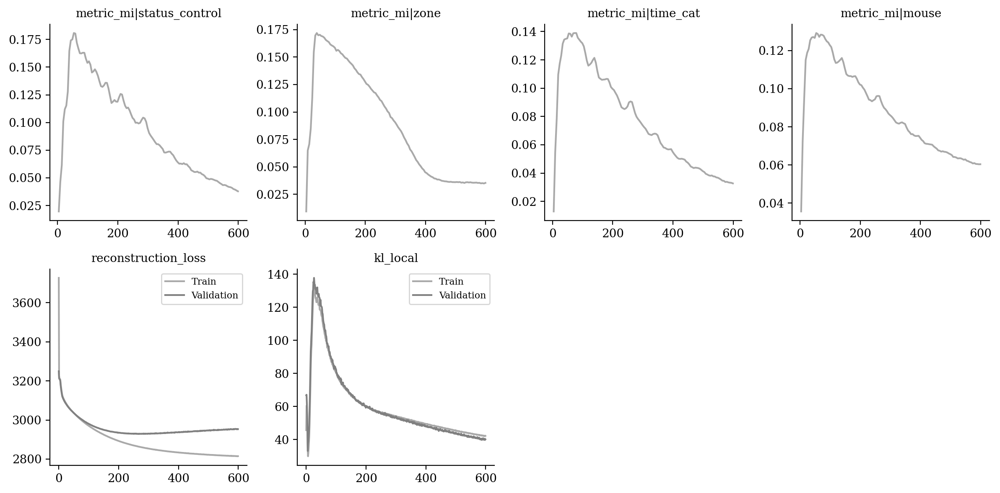

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

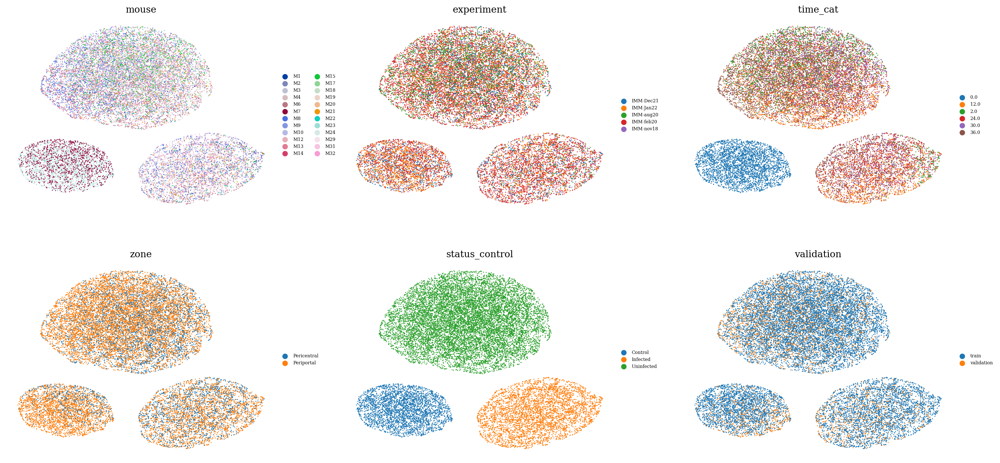

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

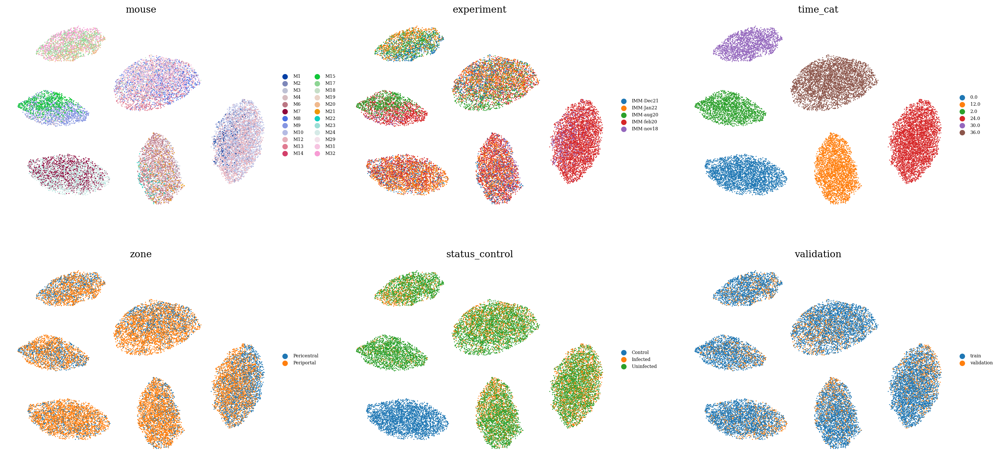

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

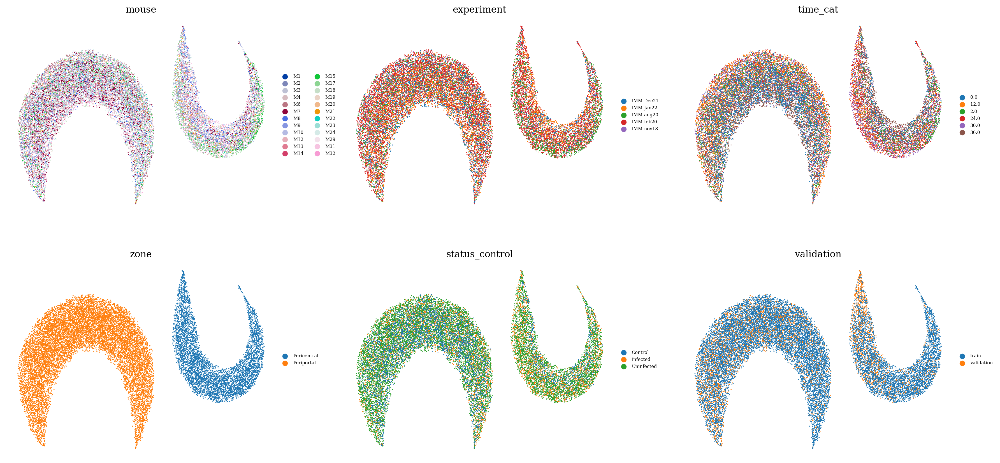

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

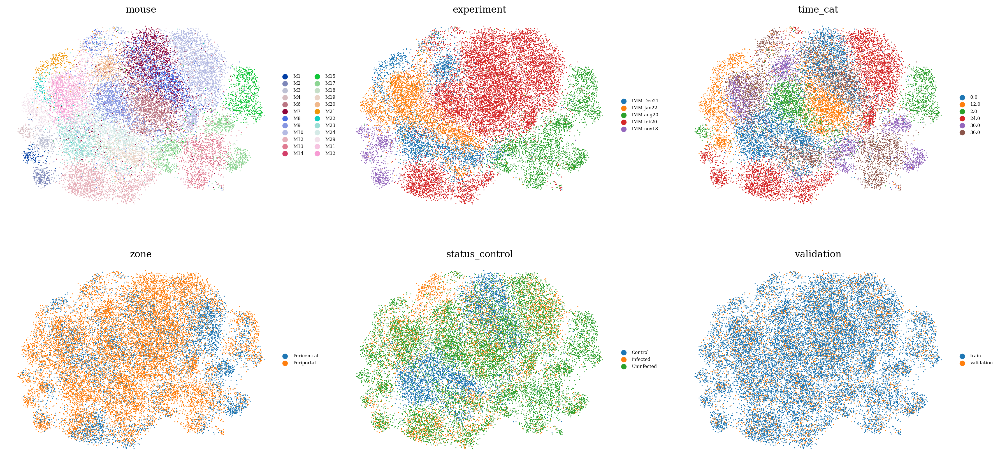

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

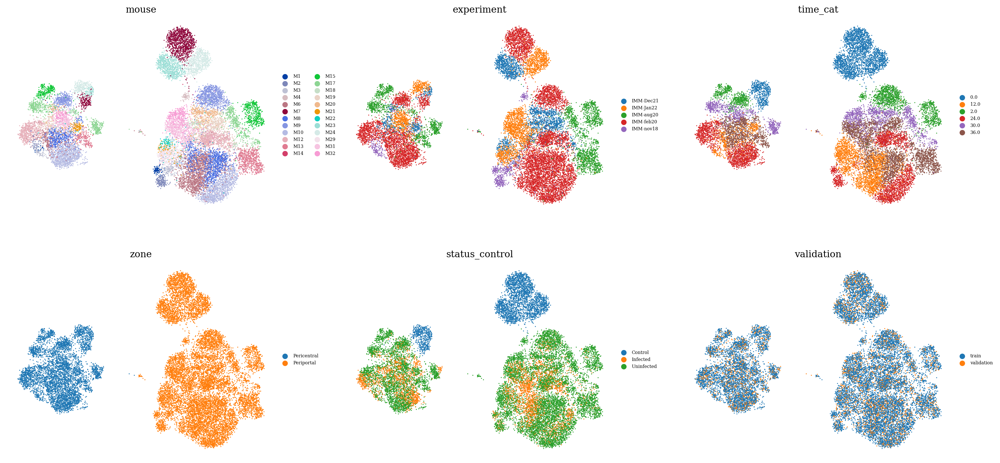

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

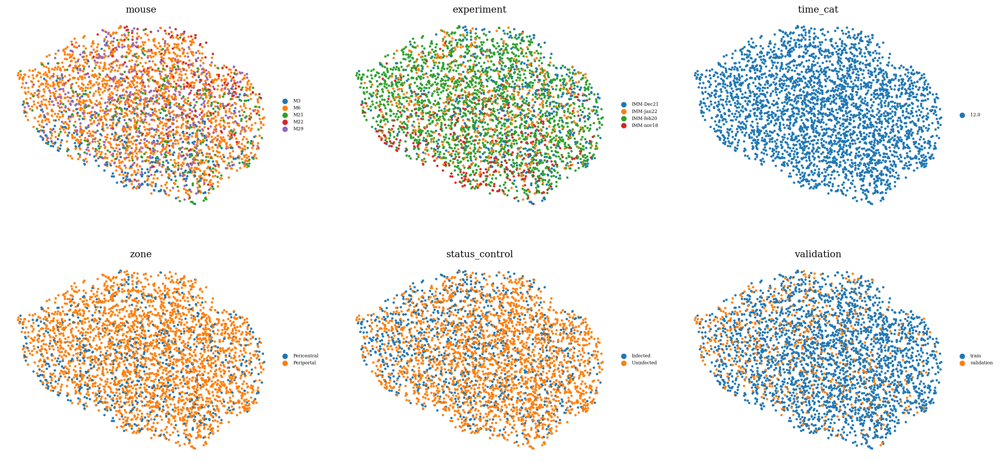

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )